# Gaussian filter

## Salt and Pepper noise:

In [ ]:
import os
import cv2
import pandas as pd
import matplotlib.pyplot as plt
import time
import numpy as np

In [ ]:
Computational_times = {}
avarage_MSE = {}
avarage_psnr = {}

prepare the original images and their noisy copies:

In [ ]:
image_folder = '/content/original_images'

data = []

for filename in os.listdir(image_folder):
    if filename.endswith(('.png', '.jpg', '.jpeg')):
        img = cv2.imread(os.path.join(image_folder, filename))
        if img is not None:
            # Convert to grayscale
            gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            data.append({'filename': filename, 'image': gray_img})

original = pd.DataFrame(data)

In [ ]:
def add_salt_pepper_noise(image, prob):
    noisy_image = image.copy()

    num_salt = np.ceil(prob * image.size * 0.5)
    coords = [np.random.randint(0, i - 1, int(num_salt)) for i in image.shape]
    noisy_image[coords[0], coords[1]] = 1

    num_pepper = np.ceil(prob * image.size * 0.5)
    coords = [np.random.randint(0, i - 1, int(num_pepper)) for i in image.shape]
    noisy_image[coords[0], coords[1]] = 0

    return noisy_image

noise_levels = [0.01, 0.08, 0.2]

noisy_data = []

for index, row in original.iterrows():
    for level in noise_levels:
        noisy_img = add_salt_pepper_noise(row['image'], level)
        noisy_data.append({
            'filename': f"{row['filename']}_noise_{level}",
            'image': noisy_img,
            'noise_level': level
        })


salty = pd.DataFrame(noisy_data)

apply the filter:

In [ ]:
Computational_times["Salt and Pepper"] = []
avarage_MSE["Salt and Pepper"] = []
avarage_psnr["Salt and Pepper"] = []

In [ ]:
def apply_gaussian_filter(image, ksize=(5, 5), sigma=1):
    filtered_image = cv2.GaussianBlur(image, ksize, sigma)
    return filtered_image

start_time = time.time()

filtered_data = []

for index, row in salty.iterrows():
    filtered_img = apply_gaussian_filter(row['image'], ksize=(5, 5), sigma=1)
    filtered_data.append({
        'filename': f"{row['filename']}_gaussian_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Salt and Pepper"].append(total_time)
print(f"Total computational time for applying Gaussian filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Gaussian filter: 0.2640 seconds


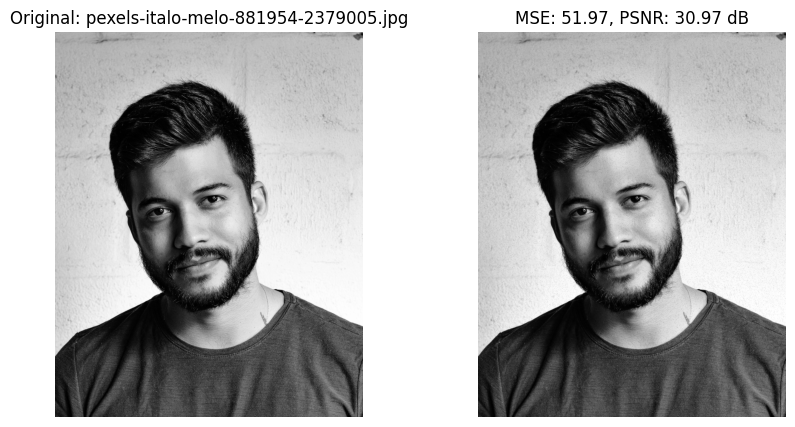

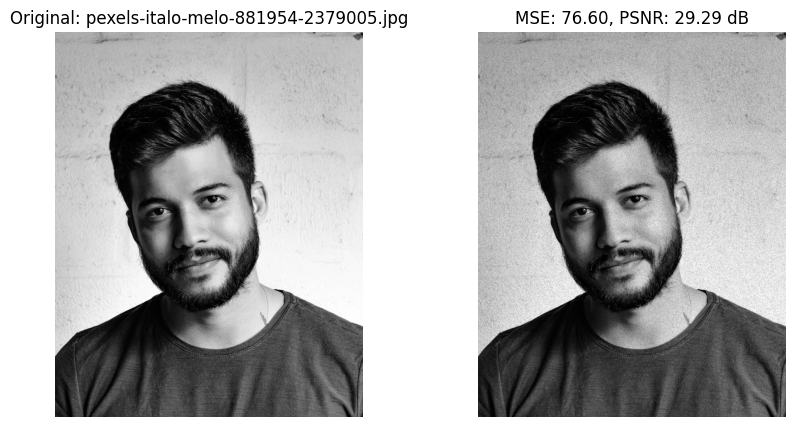

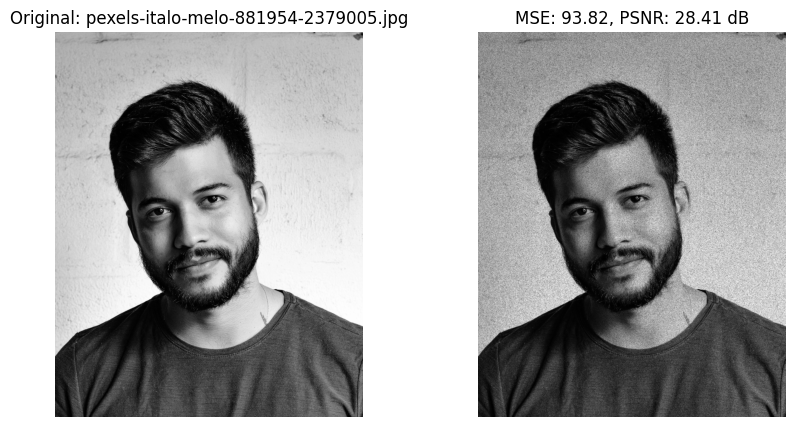

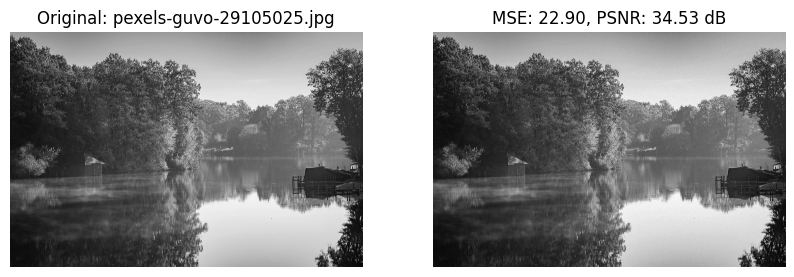

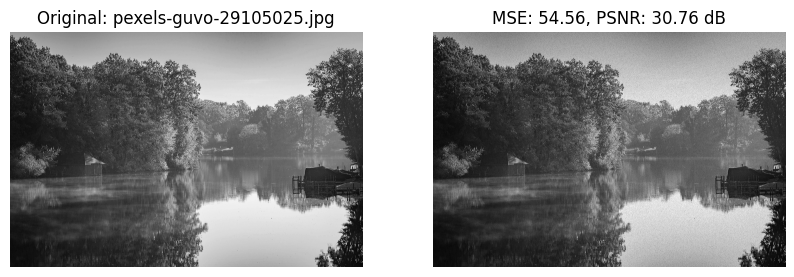

...

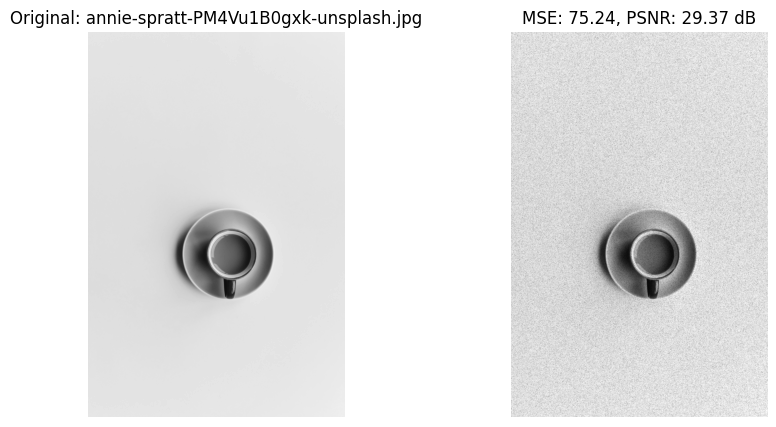

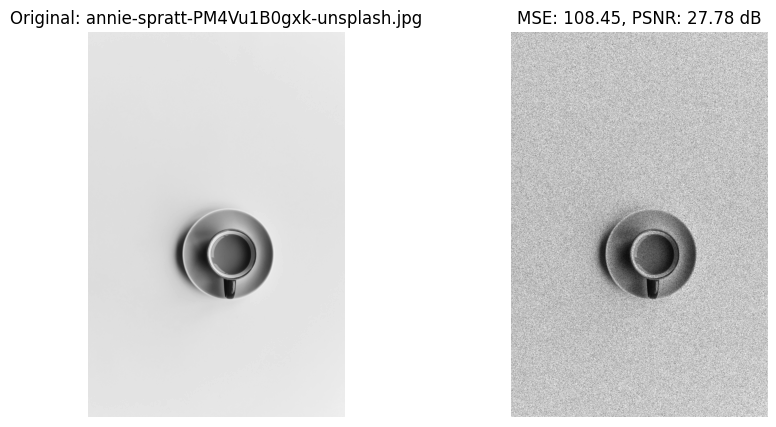

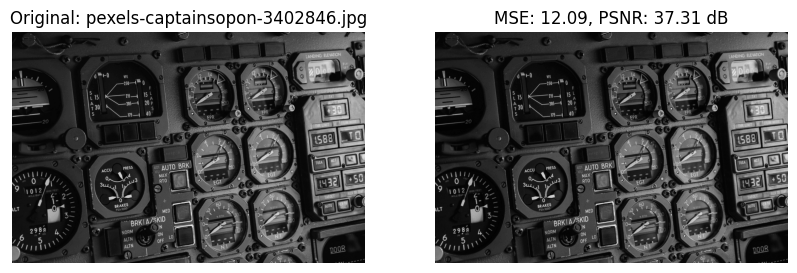

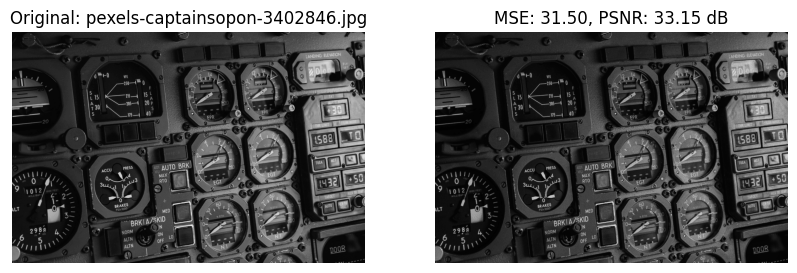

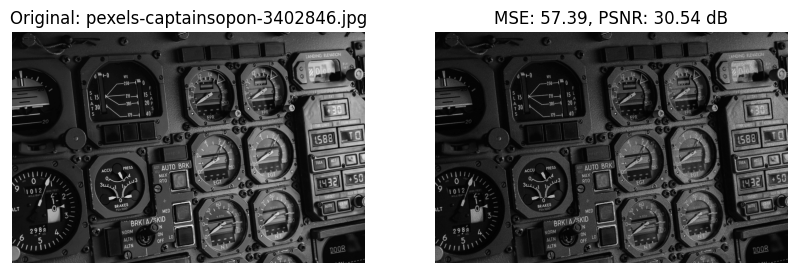

avarage mse = 57.24021525516368
avarage psnr = 31.42028016446039


In [ ]:

def calculate_mse(original, filtered):
    return np.mean((original - filtered) ** 2)

def calculate_psnr(mse, max_pixel=255.0):
    return 20 * np.log10(max_pixel) - 10 * np.log10(mse) if mse > 0 else float('inf')

counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
avarage_MSE["Salt and Pepper"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
avarage_psnr["Salt and Pepper"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

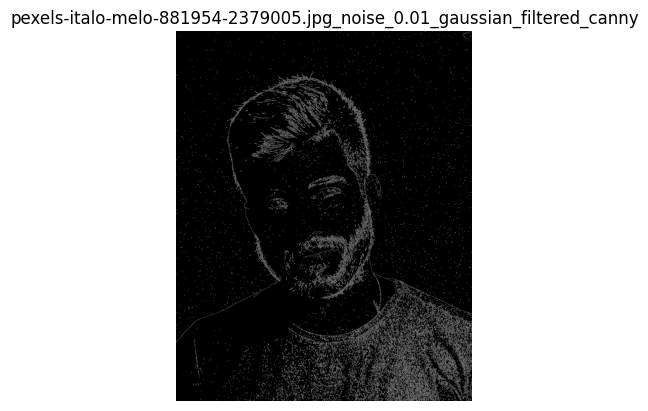

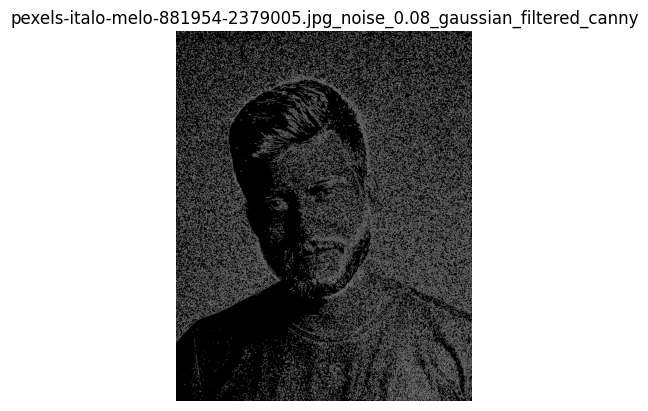

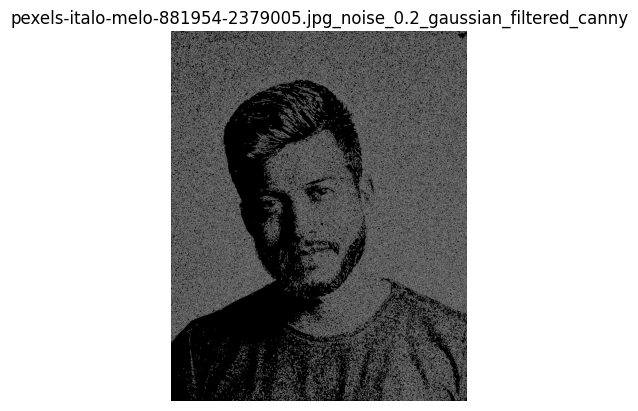

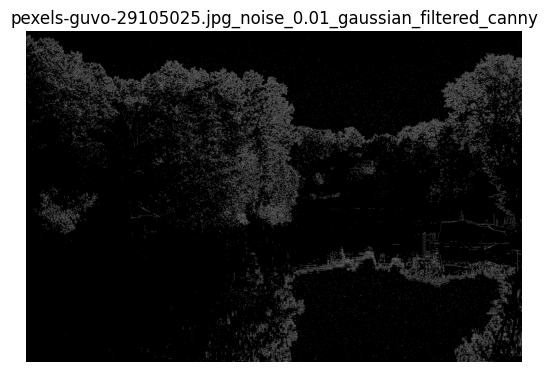

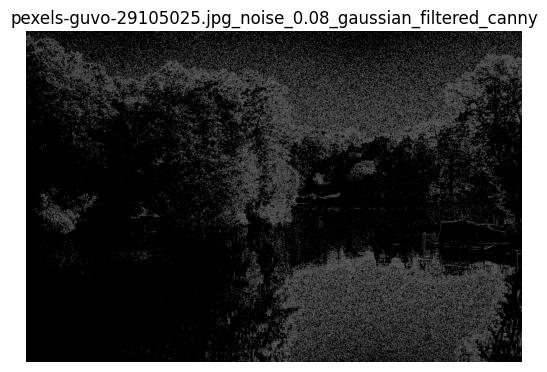

...

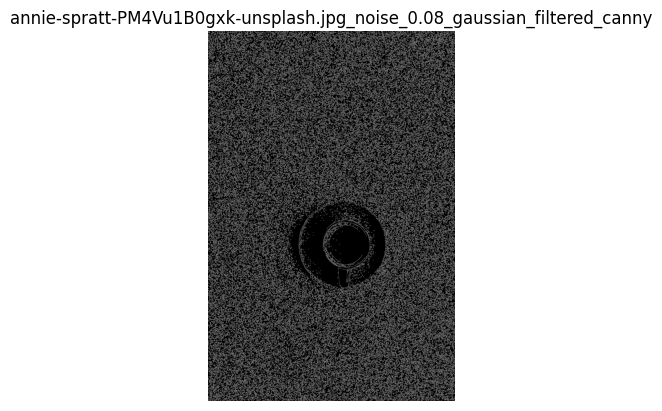

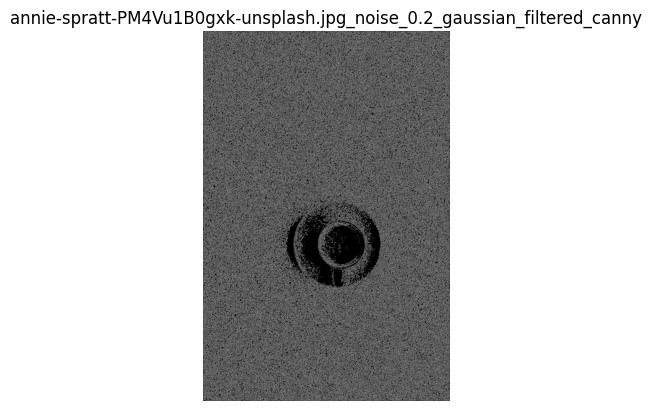

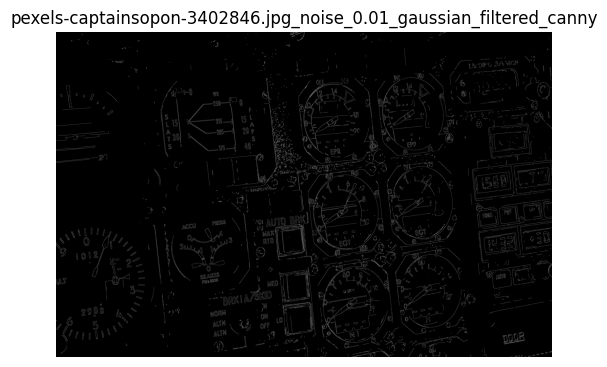

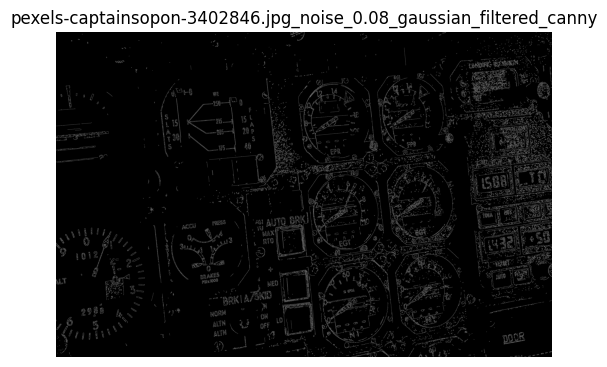

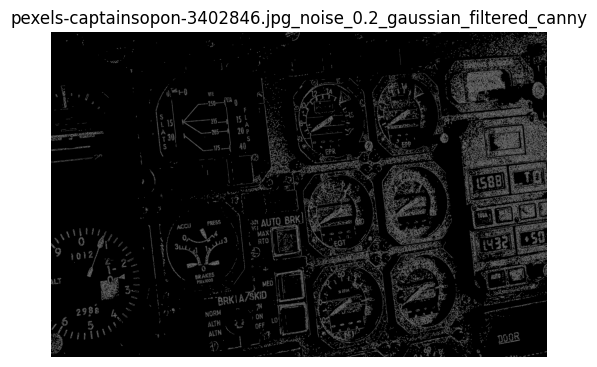

In [ ]:
def apply_canny_edge(image, threshold1=100, threshold2=200):
    edges = cv2.Canny(image, threshold1, threshold2)
    return edges

canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()


The filter couldn't get rid of the noise effect. The noise is still visible in the images, and most of it is still detected as edges, especially in images with high levels of noise.

To try and solve this we need to increase the filter effect. But for a Gaussian filter increasing the kernel size alone won't do, we also need to increase sigma. Increasing both the kernel and sigma should give us a stronger blurring effect.

In [ ]:
start_time = time.time()

filtered_data = []

for index, row in salty.iterrows():
    filtered_img = apply_gaussian_filter(row['image'], ksize=(11, 11), sigma=2)
    filtered_data.append({
        'filename': f"{row['filename']}_gaussian_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Salt and Pepper"].append(total_time)
print(f"Total computational time for applying Gaussian filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Gaussian filter: 0.9615 seconds


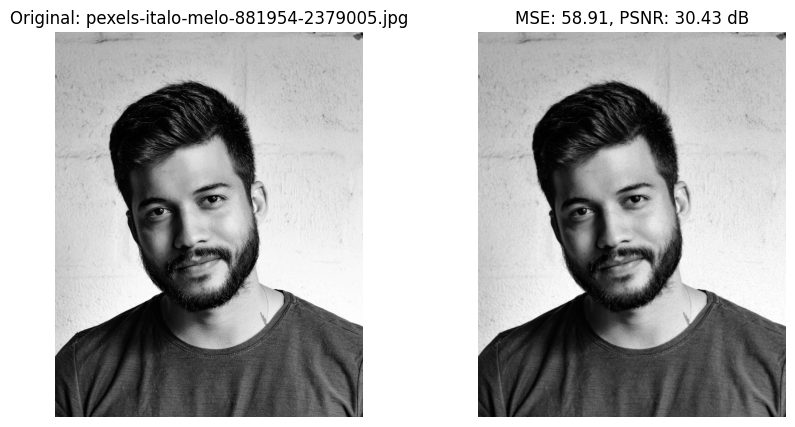

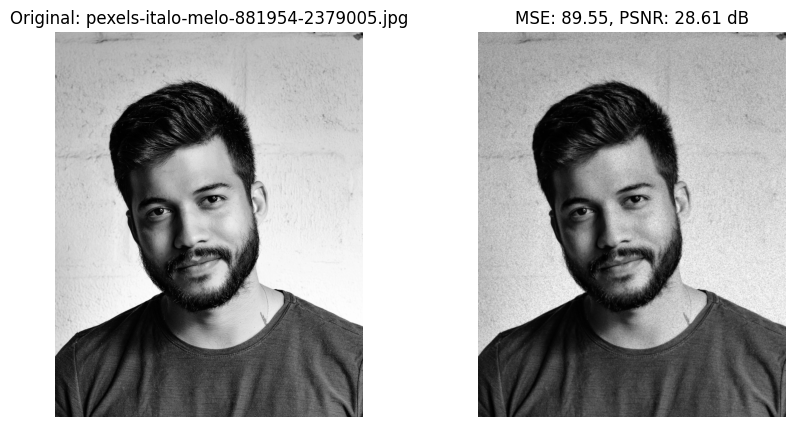

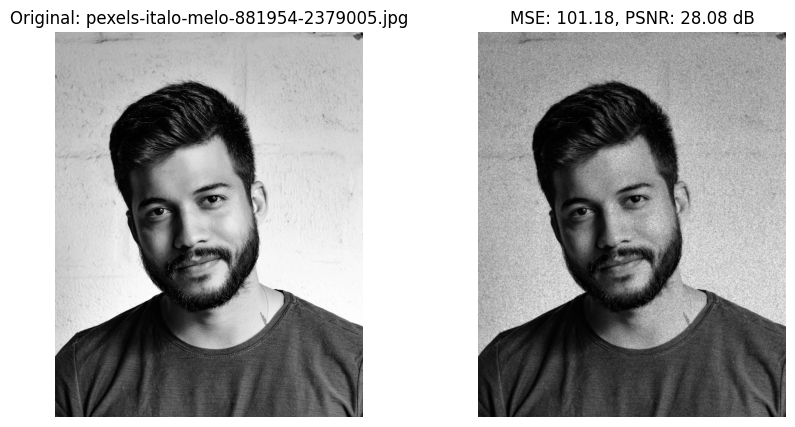

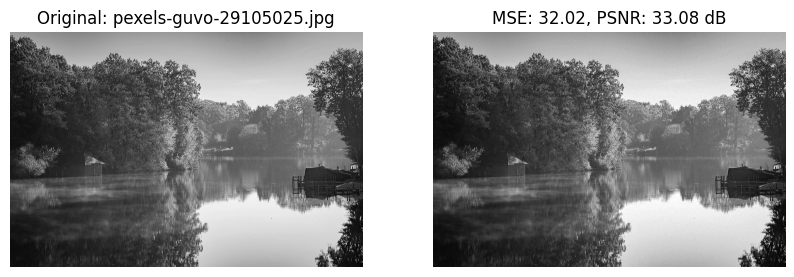

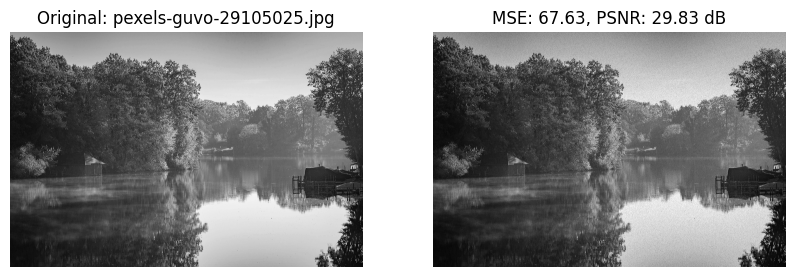

...

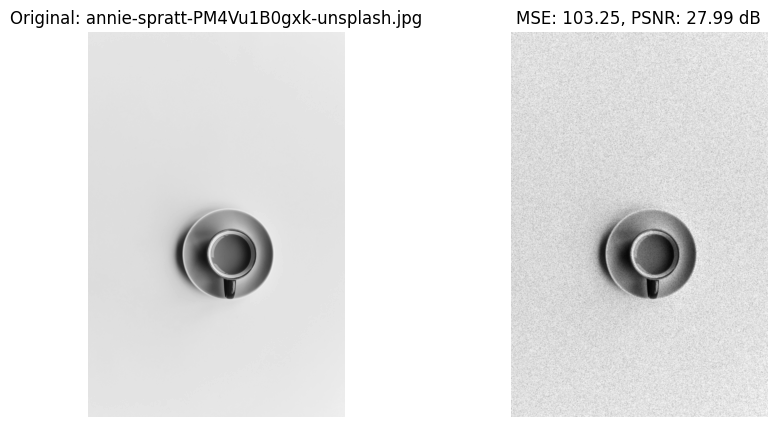

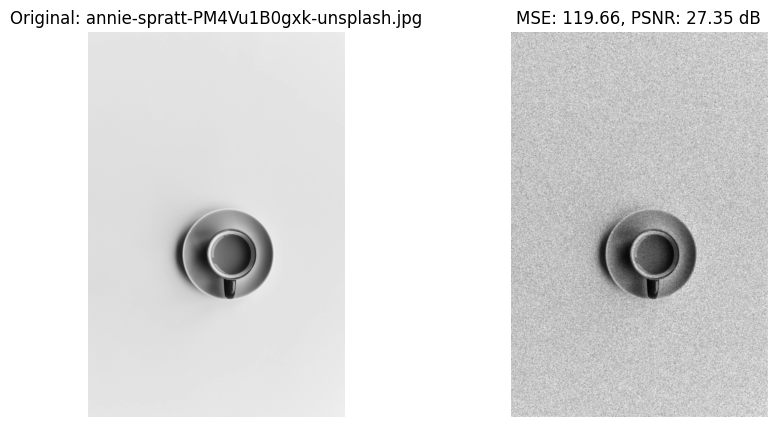

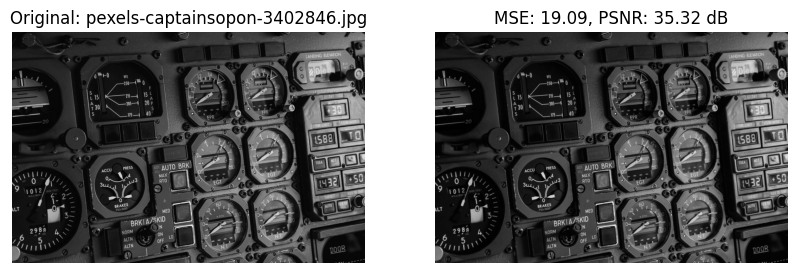

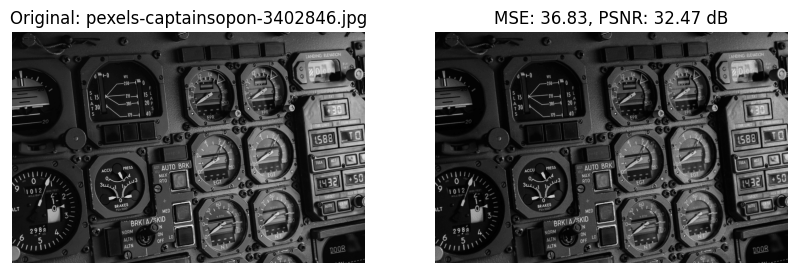

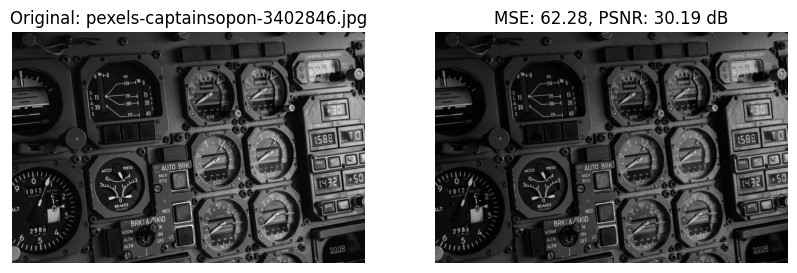

avarage mse = 66.47513688462395
avarage psnr = 30.707600298400067


In [ ]:
counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
avarage_MSE["Salt and Pepper"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
avarage_psnr["Salt and Pepper"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

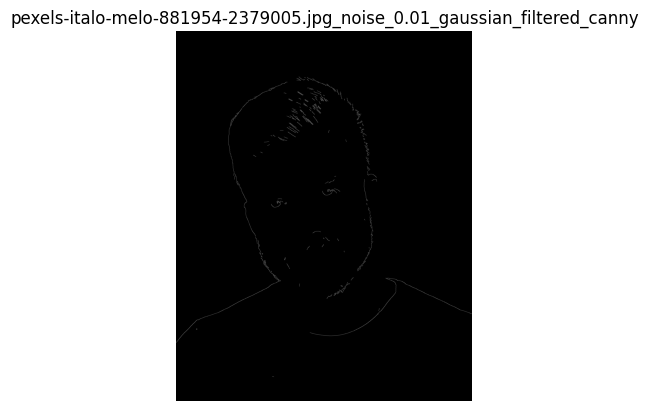

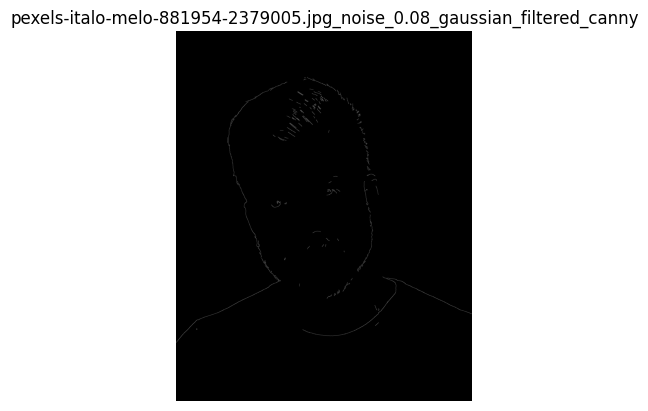

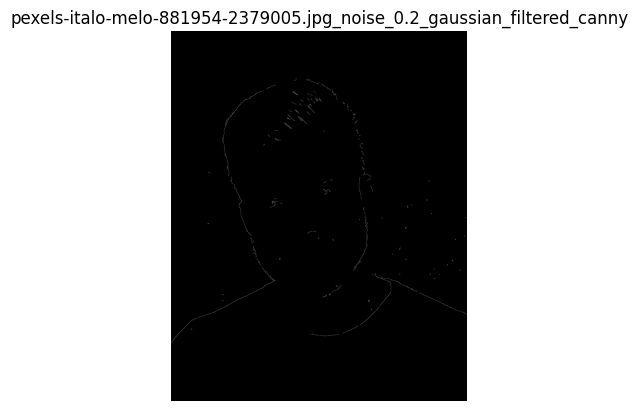

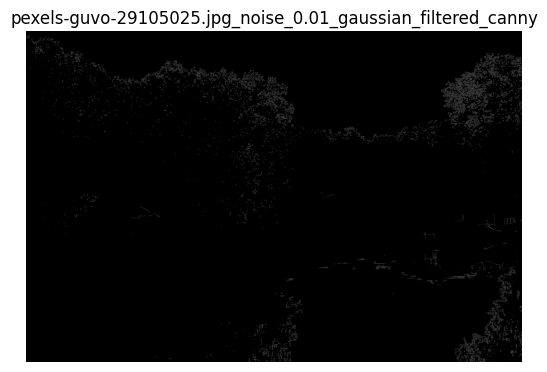

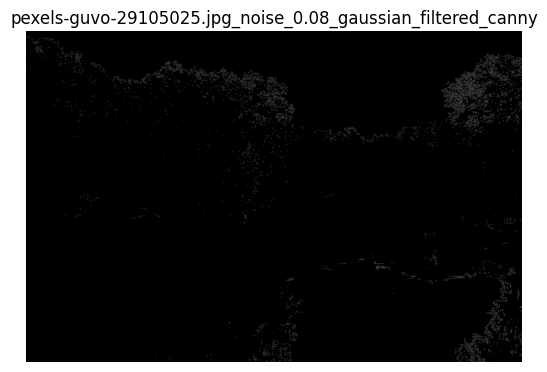

...

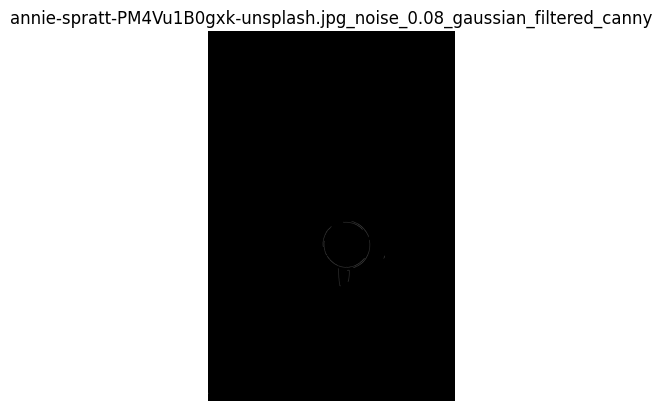

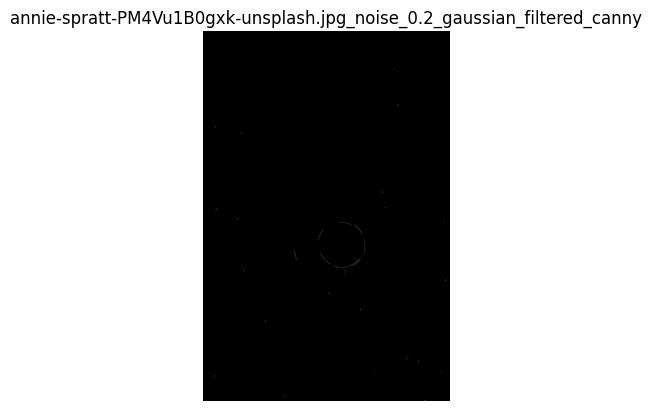

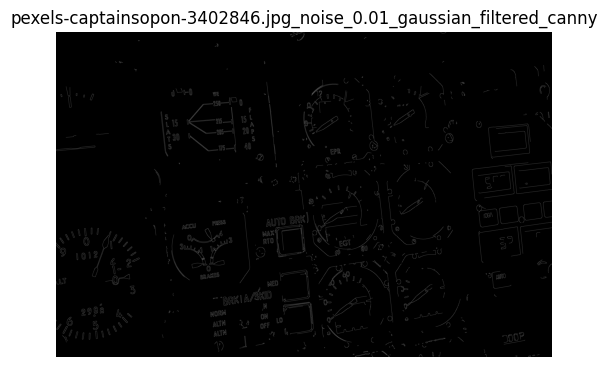

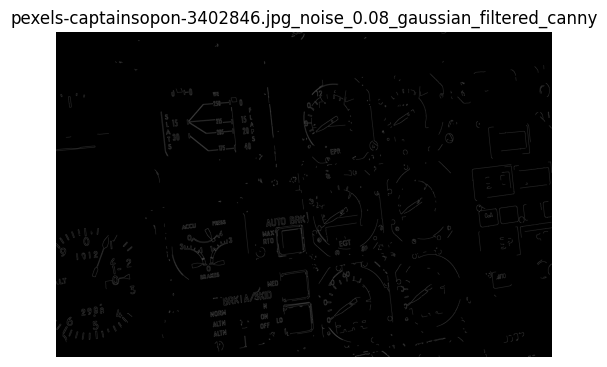

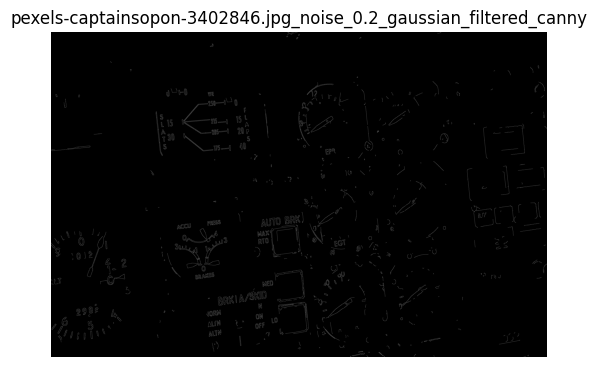

In [11]:
canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

With these new filter parameters the images did indeed become somewhat smoother, yet in highly noisy images we could still see some of the noise. Add to that that most images lose the contrast between their fine details, leading to Canny not detecting most of their edges.

This maybe because of the kernel being too big, or sigma being too big, or both. Would the smaller kernel do better with bigger sigma?


In [12]:
start_time = time.time()

filtered_data = []

for index, row in salty.iterrows():
    filtered_img = apply_gaussian_filter(row['image'], ksize=(5, 5), sigma=2)
    filtered_data.append({
        'filename': f"{row['filename']}_gaussian_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Salt and Pepper"].append(total_time)
print(f"Total computational time for applying Gaussian filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Gaussian filter: 0.1834 seconds


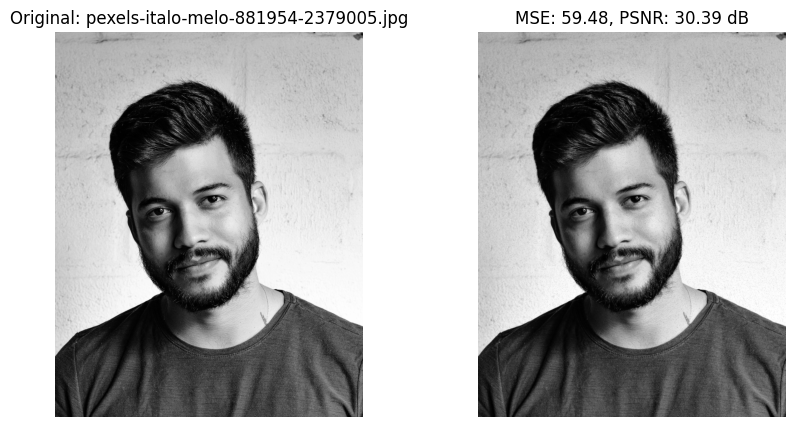

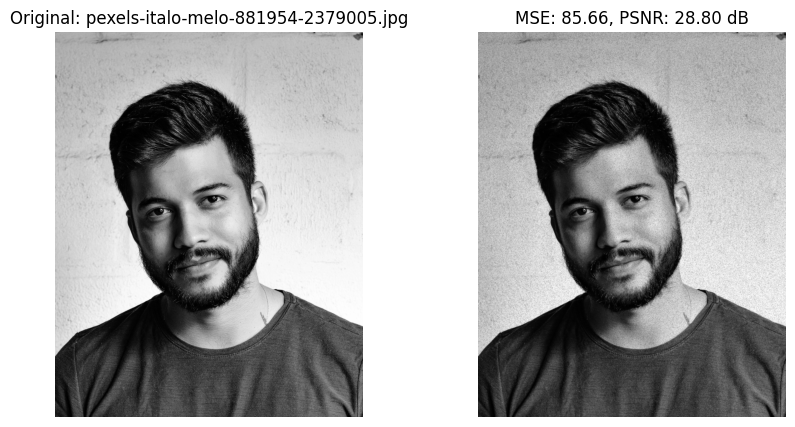

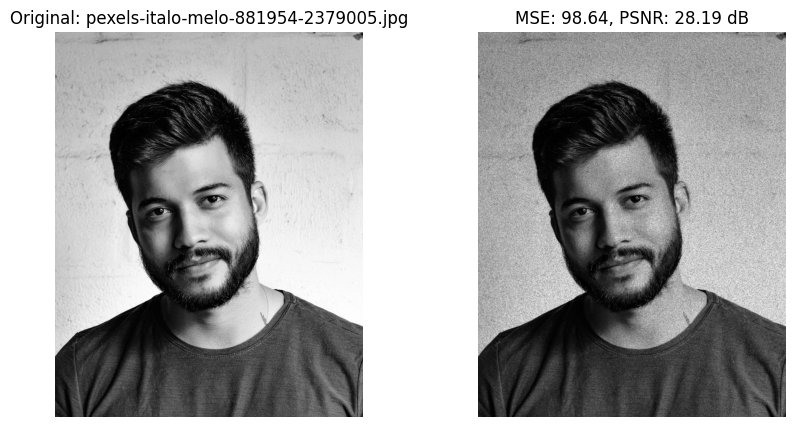

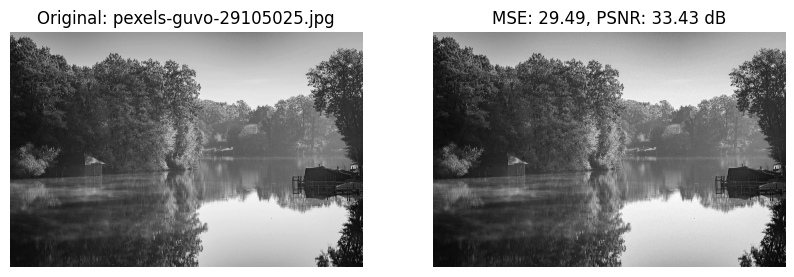

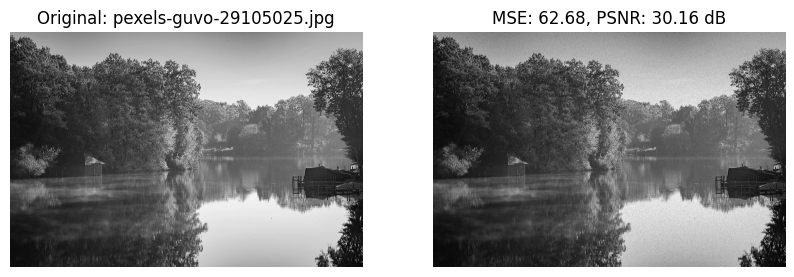

...

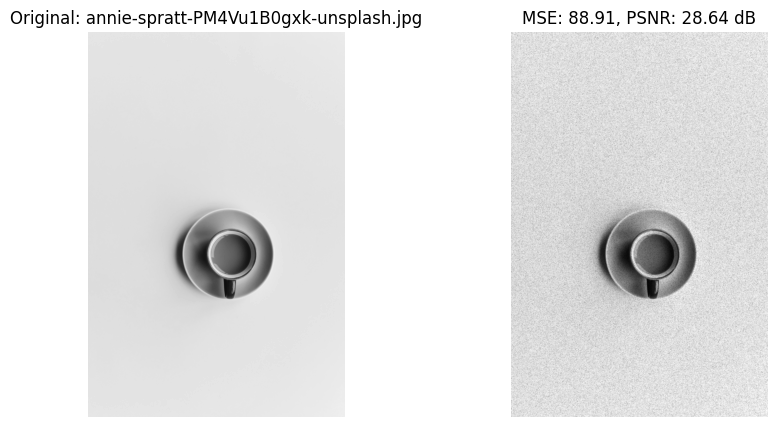

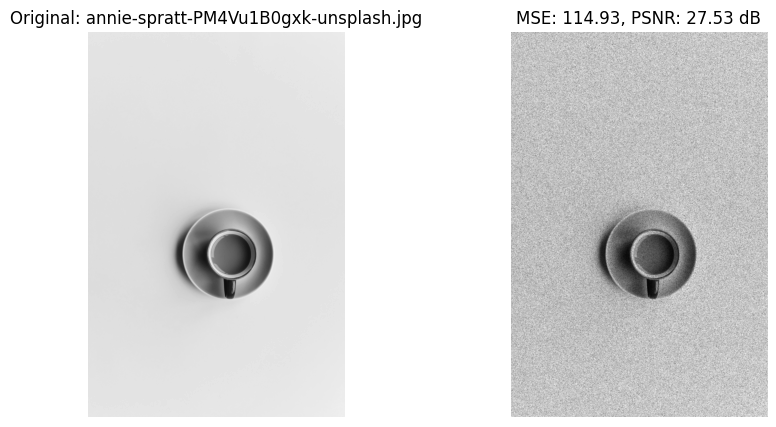

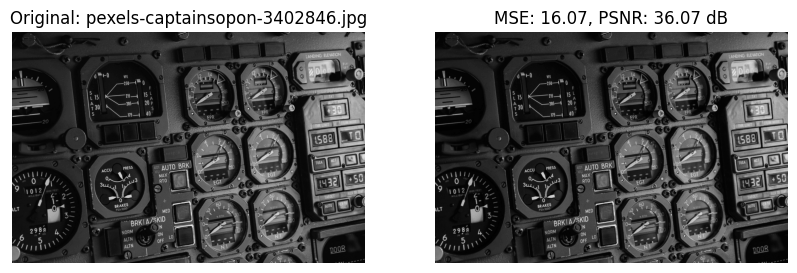

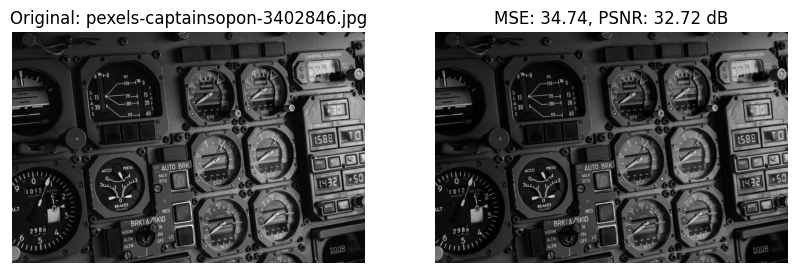

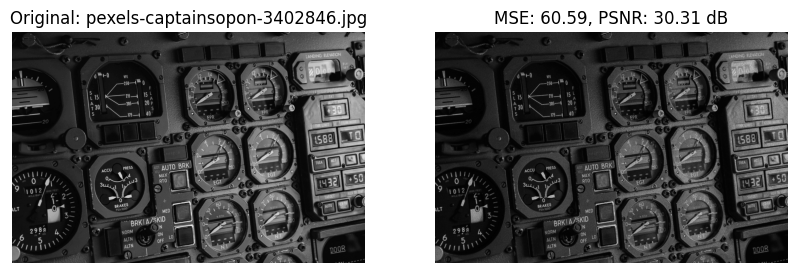

avarage mse = 63.479597940916996
avarage psnr = 30.842523747430803


In [13]:
counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
avarage_MSE["Salt and Pepper"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
avarage_psnr["Salt and Pepper"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

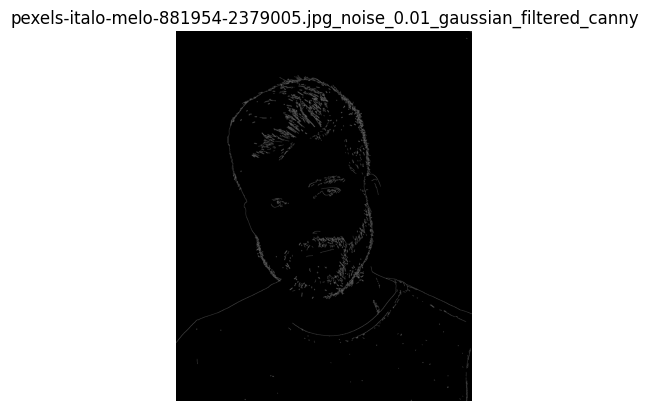

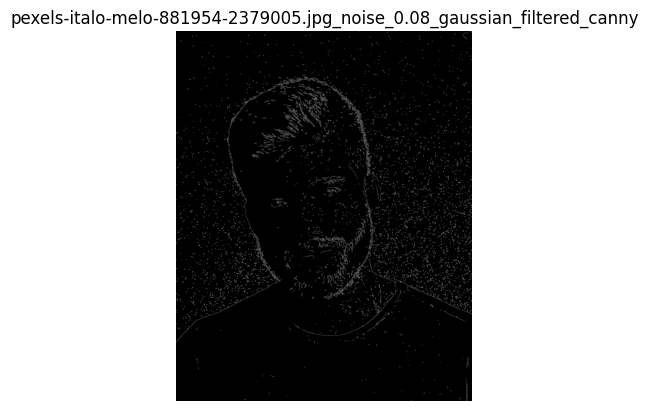

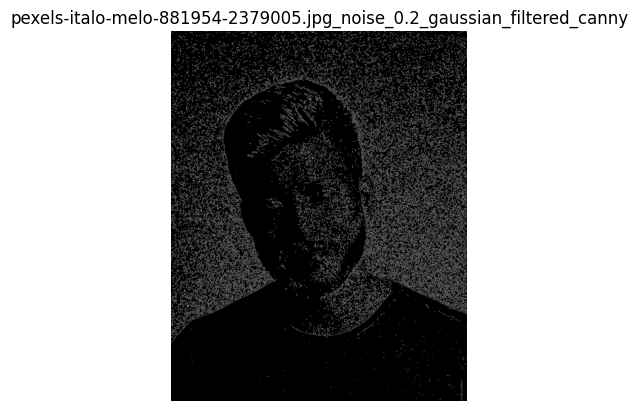

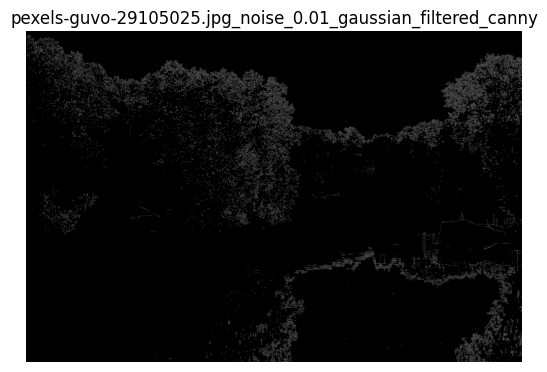

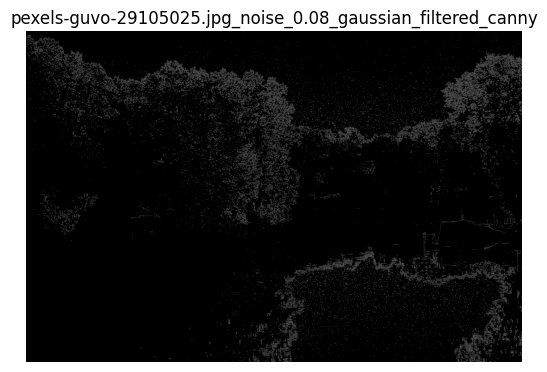

...

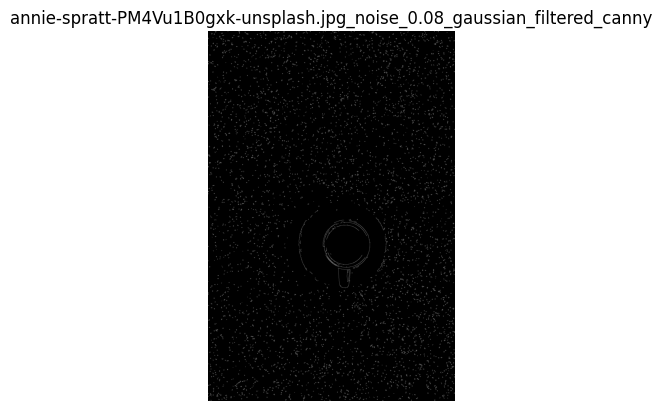

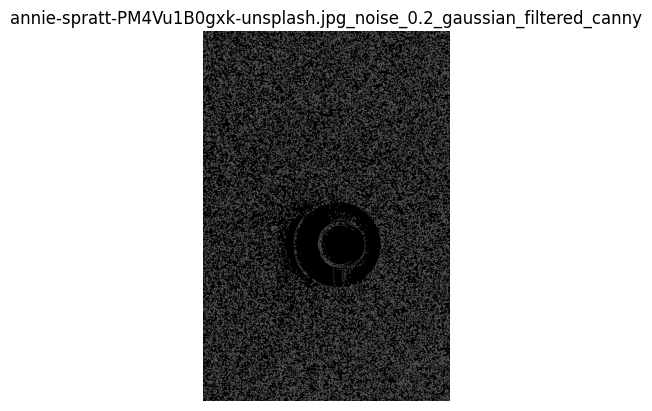

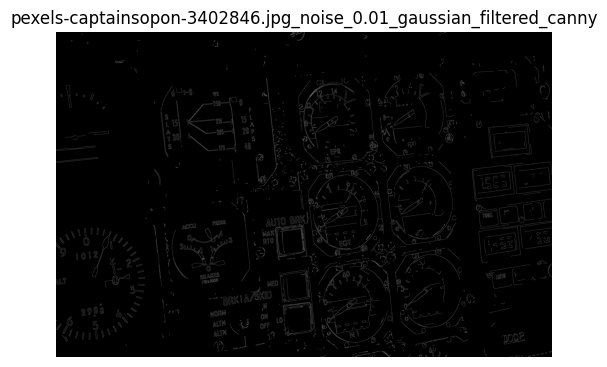

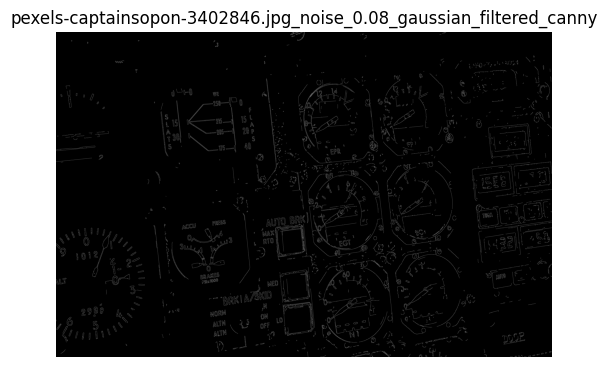

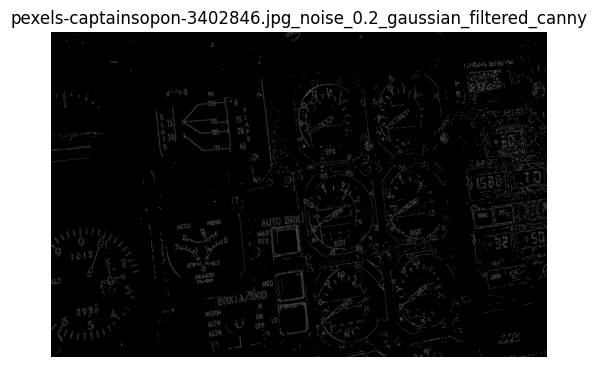

In [14]:
canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

The model with kernel 5x5 with sigma 2 did perform better on images with low and medium noise levels. Also it maintained the images better than the model with kernel 11x11 and sigma 2.

How would a model with kernel 11x11 and sigma 1 do?

In [15]:
start_time = time.time()

filtered_data = []

for index, row in salty.iterrows():
    filtered_img = apply_gaussian_filter(row['image'], ksize=(11, 11), sigma=1)
    filtered_data.append({
        'filename': f"{row['filename']}_gaussian_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Salt and Pepper"].append(total_time)
print(f"Total computational time for applying Gaussian filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Gaussian filter: 0.3972 seconds


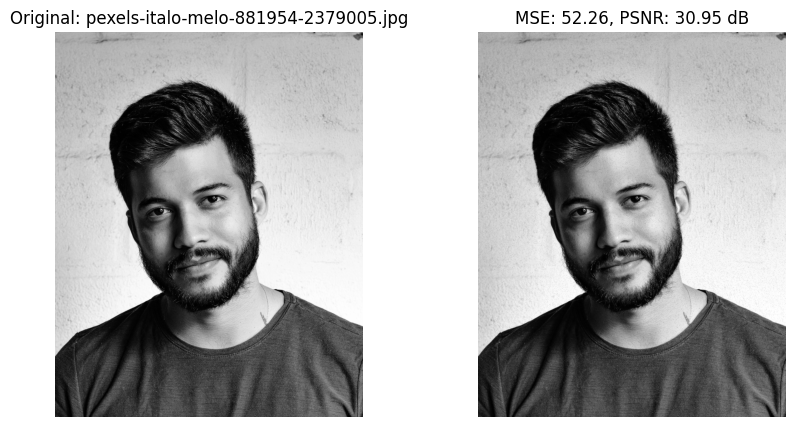

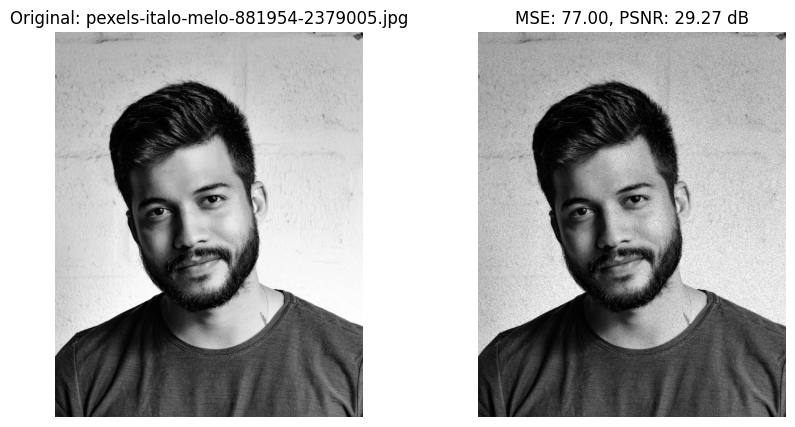

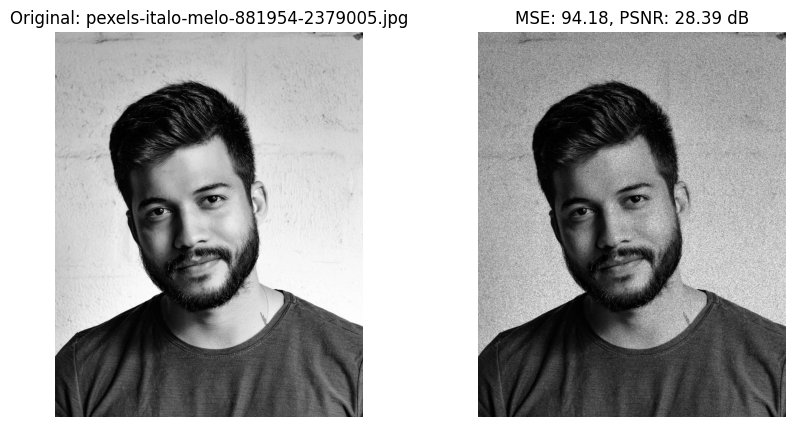

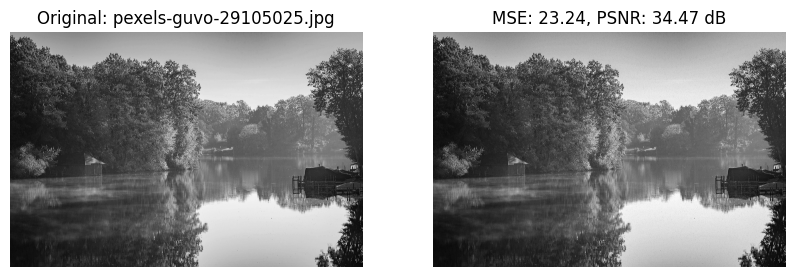

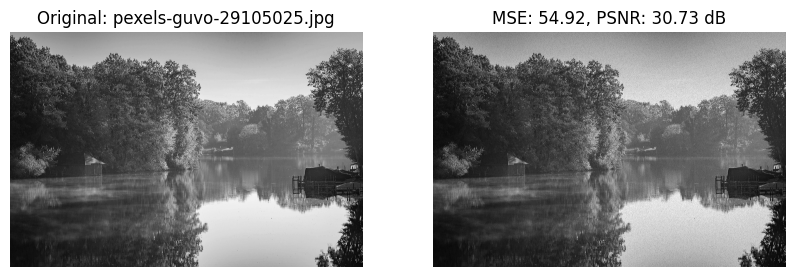

...

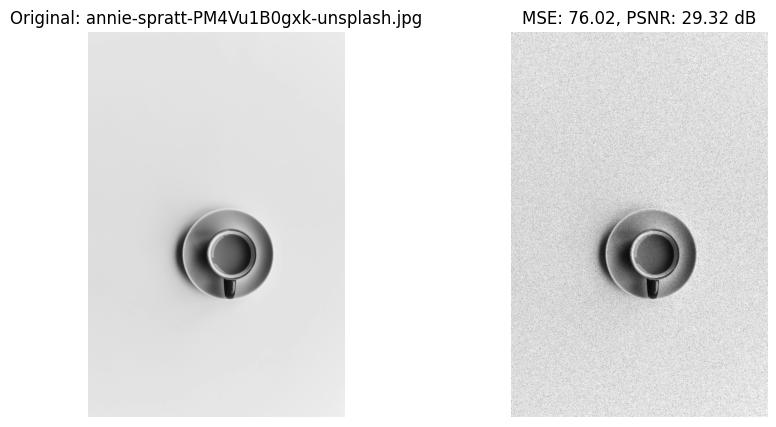

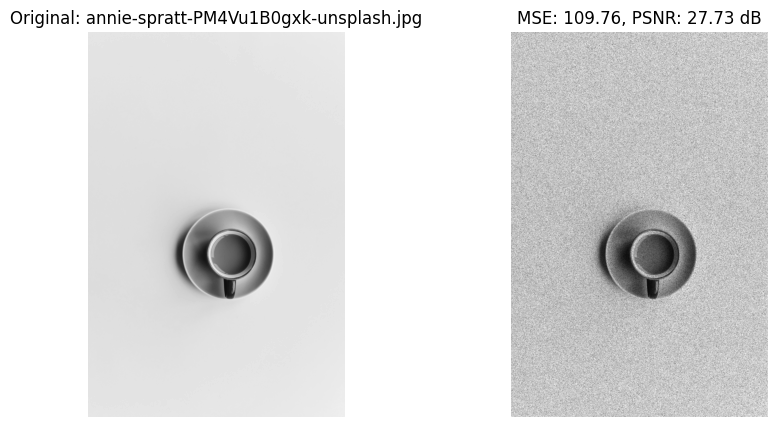

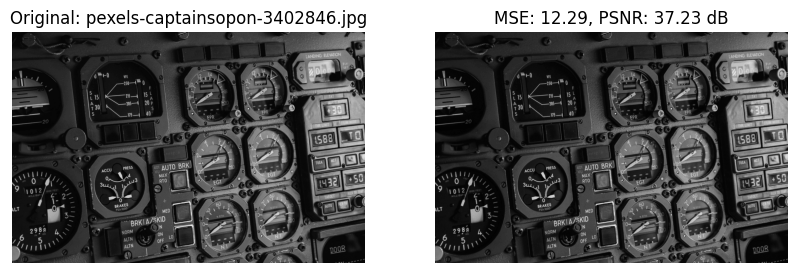

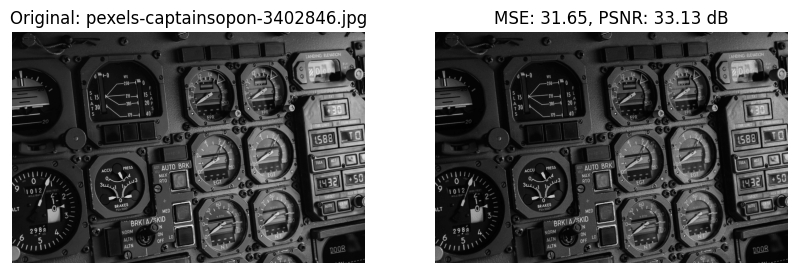

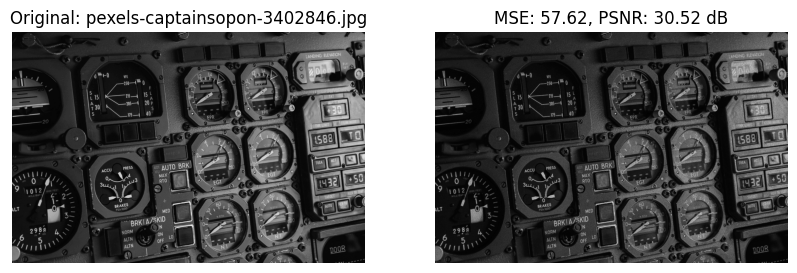

avarage mse = 57.656650739892676
avarage psnr = 31.384867738521265


In [16]:
counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
avarage_MSE["Salt and Pepper"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
avarage_psnr["Salt and Pepper"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

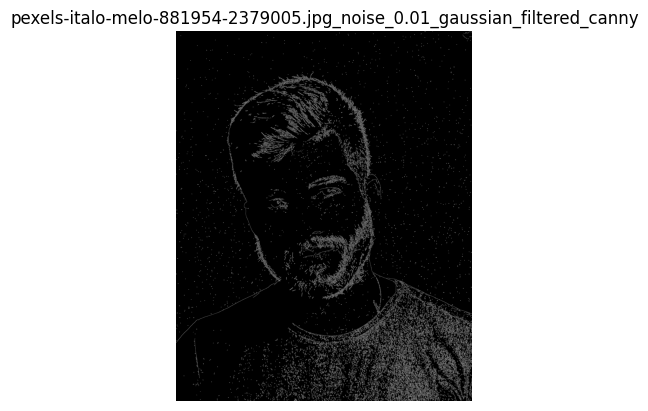

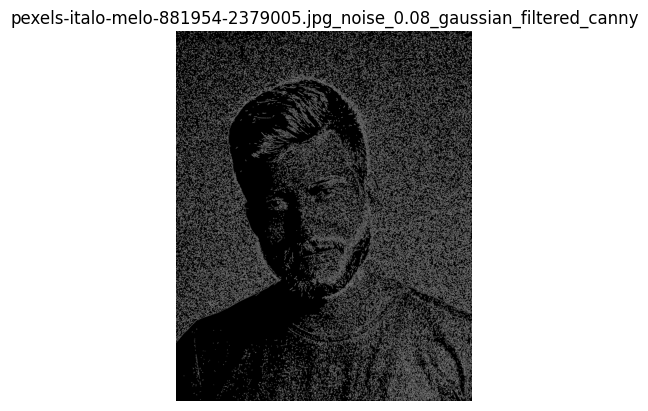

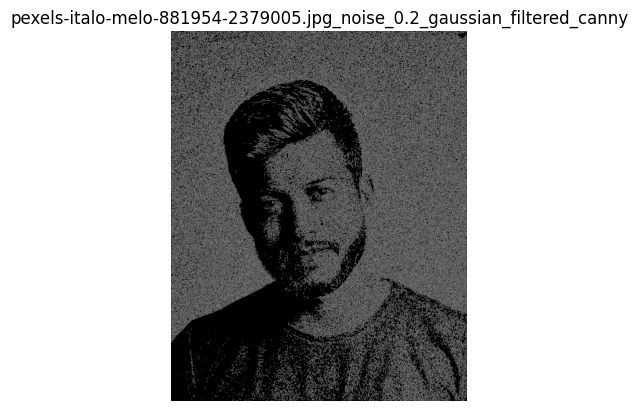

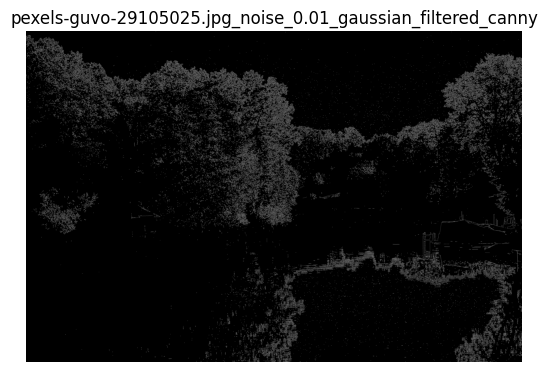

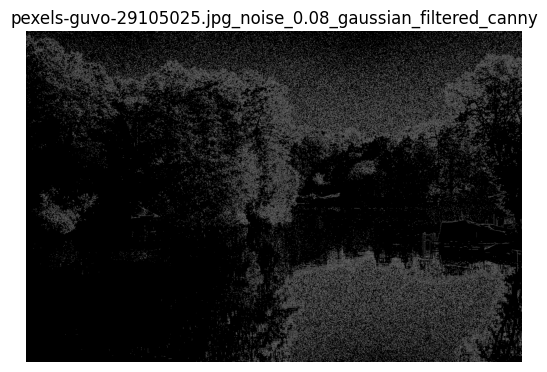

...

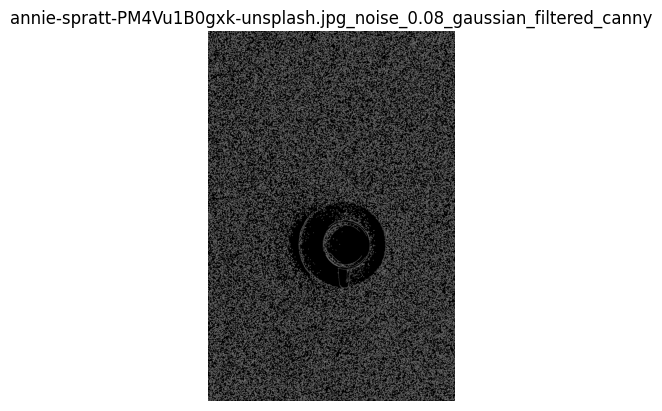

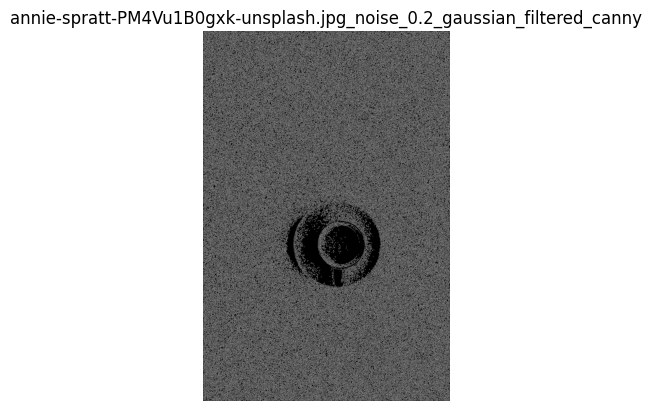

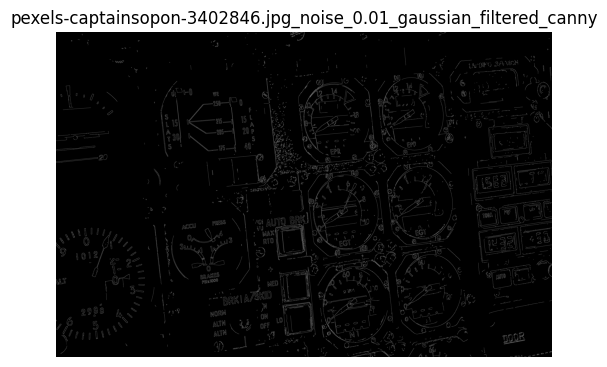

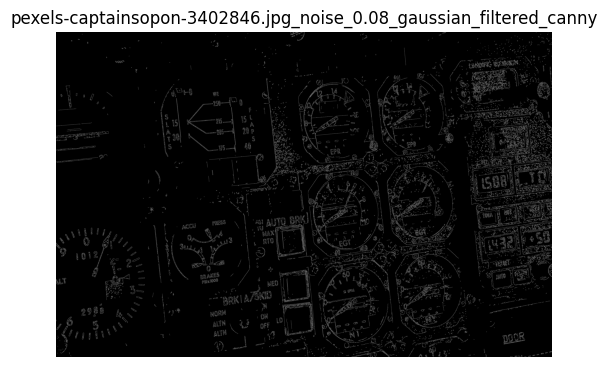

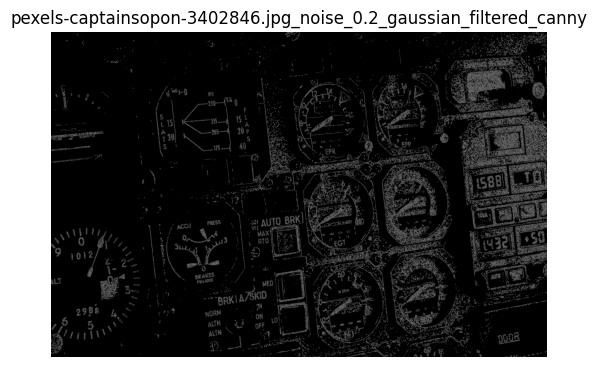

In [17]:
canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

This model didn't do any differently from the one with kernel 5x5 and sigma 1. A much bigger kernel with a still small sigma didn't lead to improvement on the Gaussian filter, as the further from the center pixels in the kernel (far neighbors) were given a very small weight to lead to any change.


Even the average MSE and PSNR were found to be the same.

# Gaussian Nose:

In [20]:

def add_gaussian_noise(image, var, mean=20):
    sigma = var**0.5
    gaussian_noise = np.random.normal(mean, sigma, image.shape)

    noisy_image = image + gaussian_noise

    noisy_image = np.clip(noisy_image, 0, 255).astype(np.uint8)

    return noisy_image

gaussian_variances = [500, 1000, 2000]

noisy_data_gaussian = []

for index, row in original.iterrows():
    for var in gaussian_variances:
        noisy_img = add_gaussian_noise(row['image'], var=var)
        noisy_data_gaussian.append({
            'filename': f"{row['filename']}_gaussian_{var}",
            'image': noisy_img,
            'variance': var
        })

gaussian_noise = pd.DataFrame(noisy_data_gaussian)


In [18]:
Computational_times["Gaussian"] = []
avarage_MSE["Gaussian"] = []
avarage_psnr["Gaussian"] = []

In [27]:
start_time = time.time()

filtered_data = []

for index, row in gaussian_noise.iterrows():
    filtered_img = apply_gaussian_filter(row['image'], ksize=(5, 5), sigma=1)
    filtered_data.append({
        'filename': f"{row['filename']}_gaussian_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Gaussian"].append(total_time)
print(f"Total computational time for applying Gaussian filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Gaussian filter: 0.2011 seconds


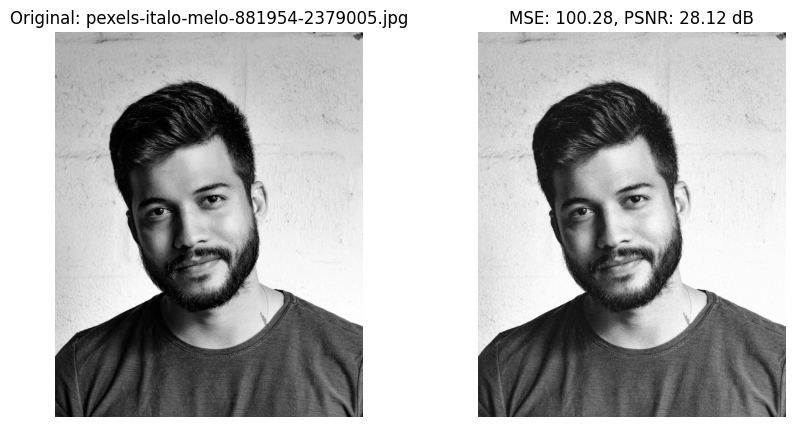

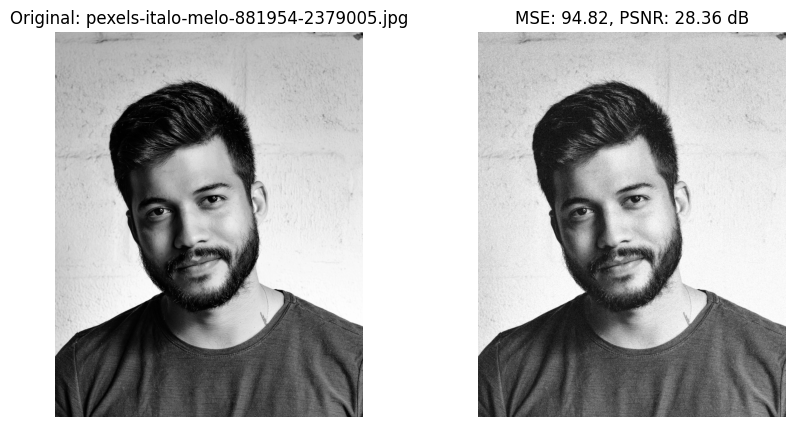

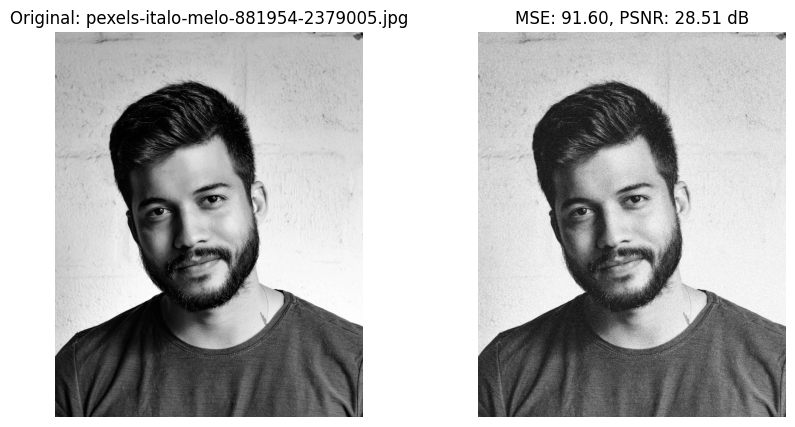

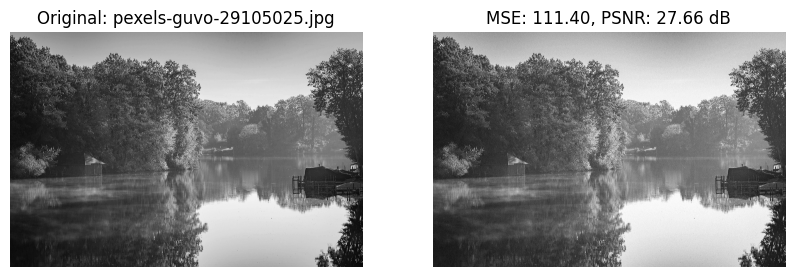

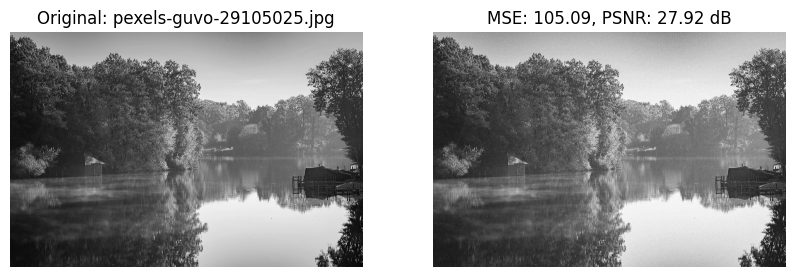

...

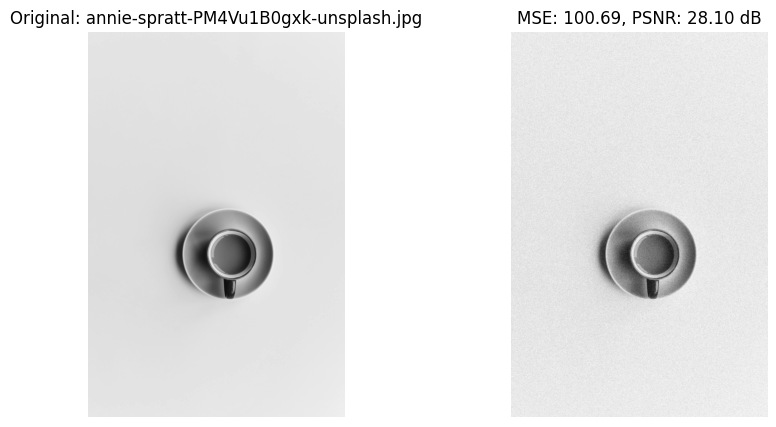

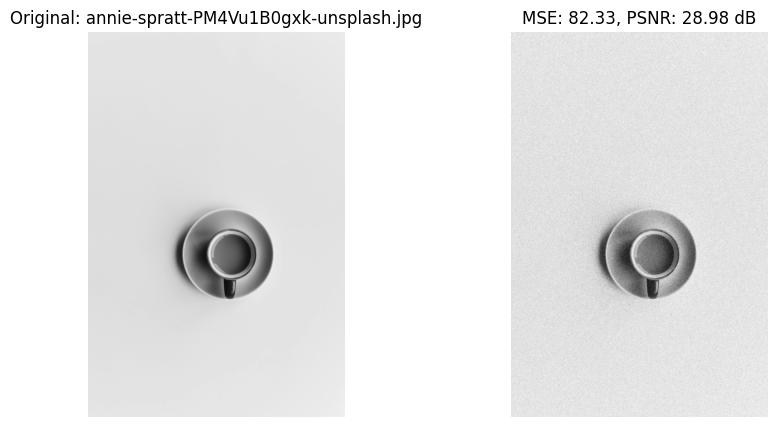

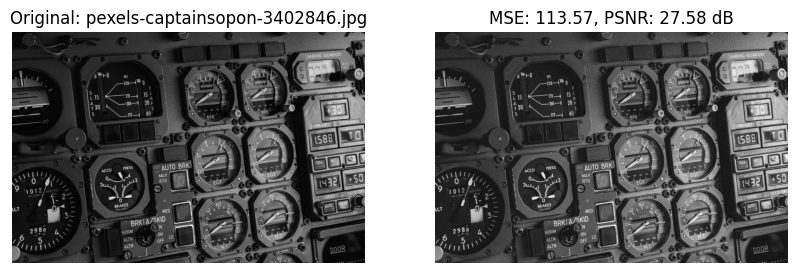

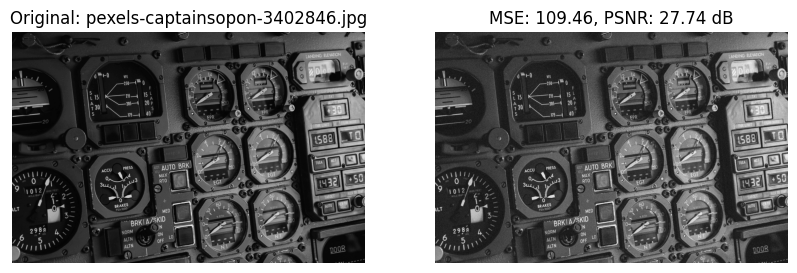

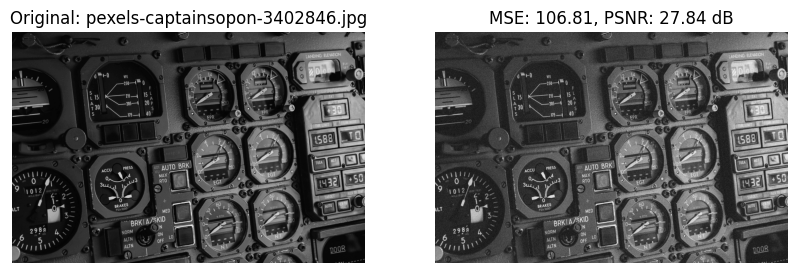

avarage mse = 102.43205302699153
avarage psnr = 28.044699259065865


In [28]:
counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
avarage_MSE["Gaussian"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
avarage_psnr["Gaussian"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

A big average MSE could be noticed here. As the Gaussian noise smoothes the image and disrupts its details. And the Gaussian filter way of fixing this smoothes and blurs the image even more.

All this leads to the pixels having far different values from the ones in the original one.


However, the PSNR is somewhat small.

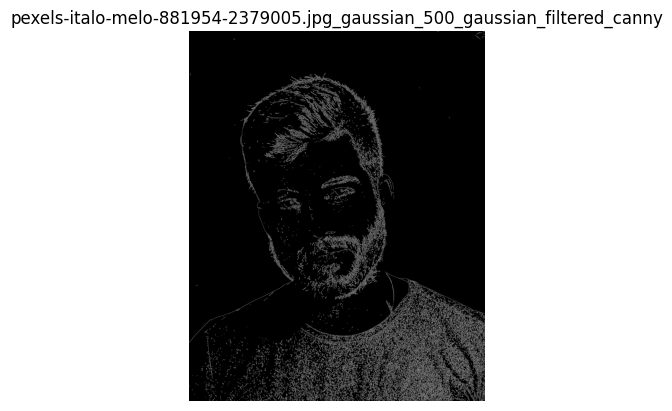

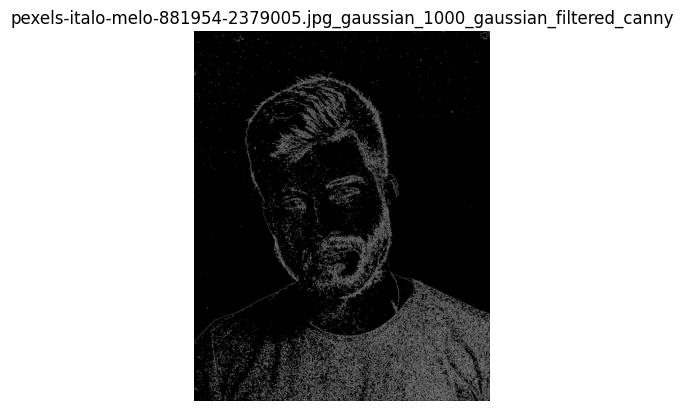

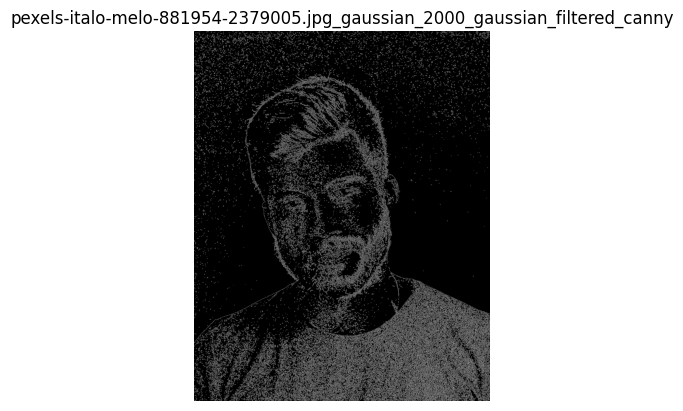

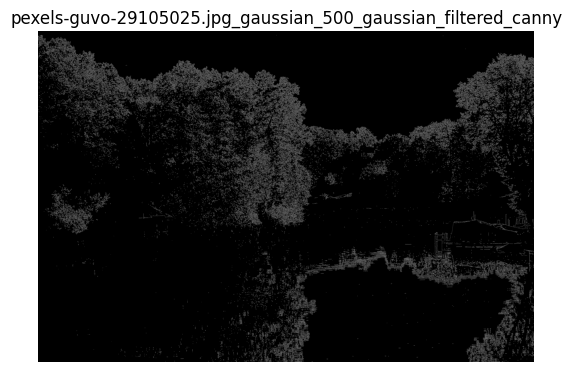

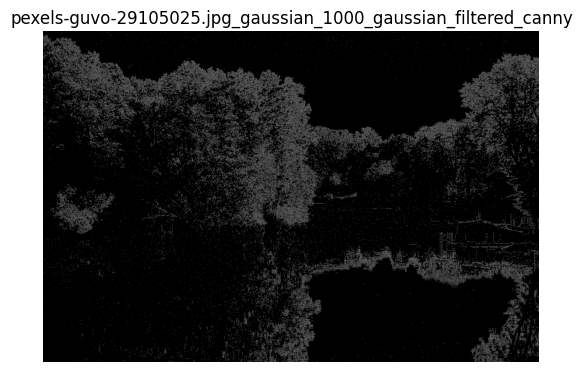

...

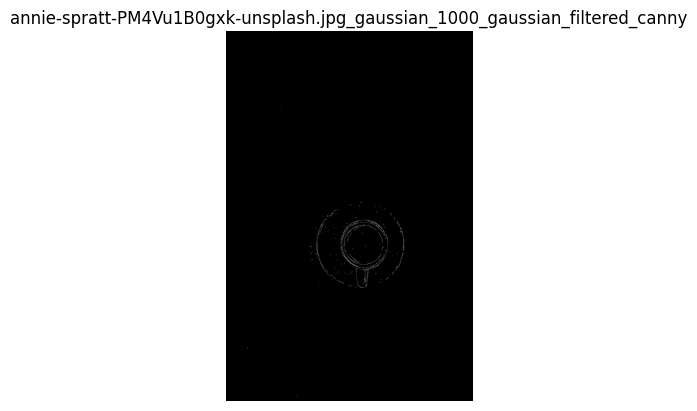

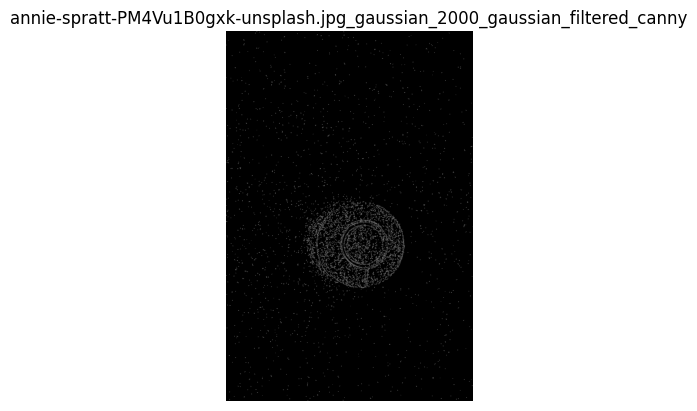

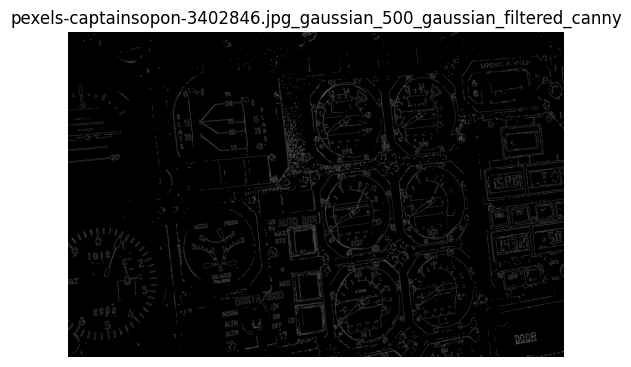

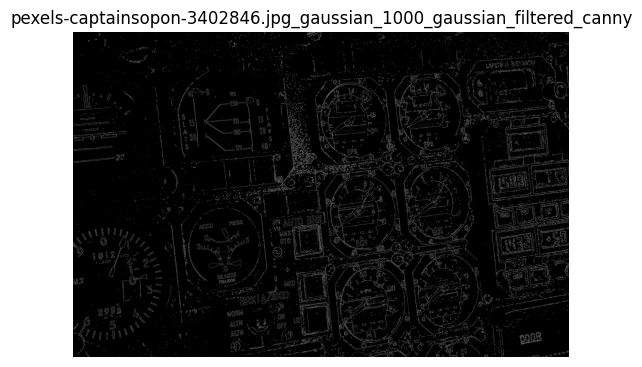

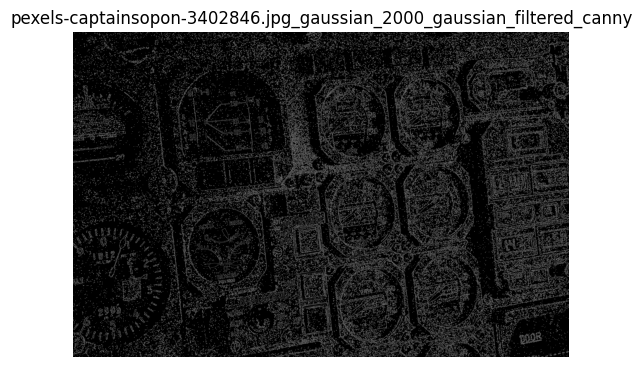

In [23]:
canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

Canny can't differentiate between objects and backgrounds anymore. Everything has an edge to it, as the edges have been too smooth and blurred with what is around them.


What now could be seen in Canny's output are compact edges, or too thick ones.

Seeing as the filter with kernel 5x5 and sigma 2 performed the best on salt and pepper noise, I'm curious to see how it'll perform on a Gaussian filter.

In [29]:
start_time = time.time()

filtered_data = []

for index, row in gaussian_noise.iterrows():
    filtered_img = apply_gaussian_filter(row['image'], ksize=(5, 5), sigma=2)
    filtered_data.append({
        'filename': f"{row['filename']}_gaussian_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Gaussian"].append(total_time)
print(f"Total computational time for applying Gaussian filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Gaussian filter: 0.2120 seconds


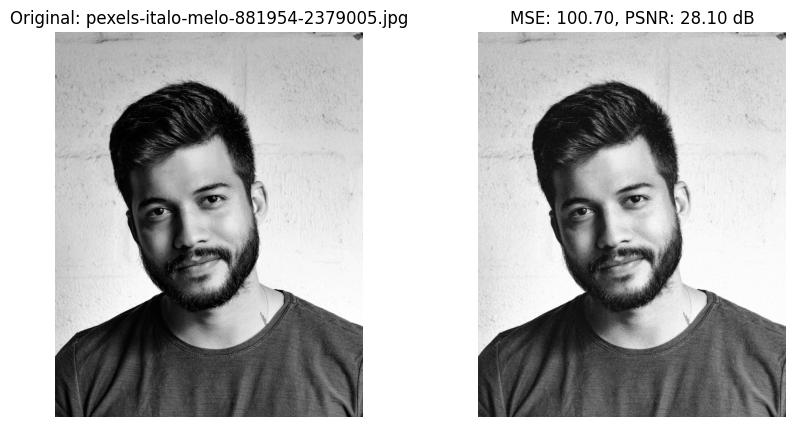

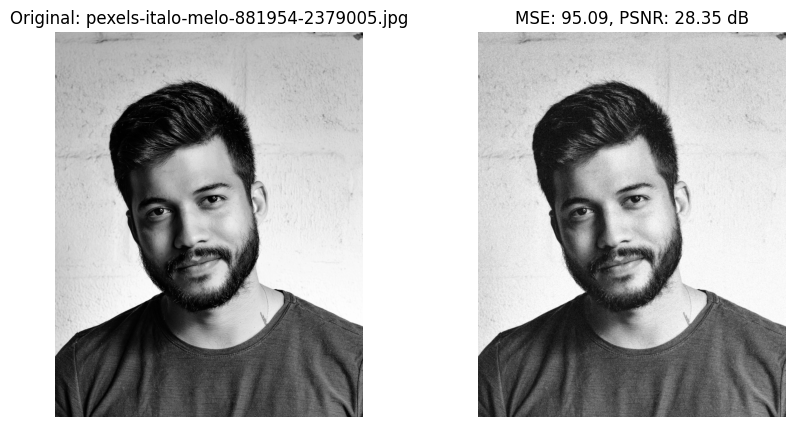

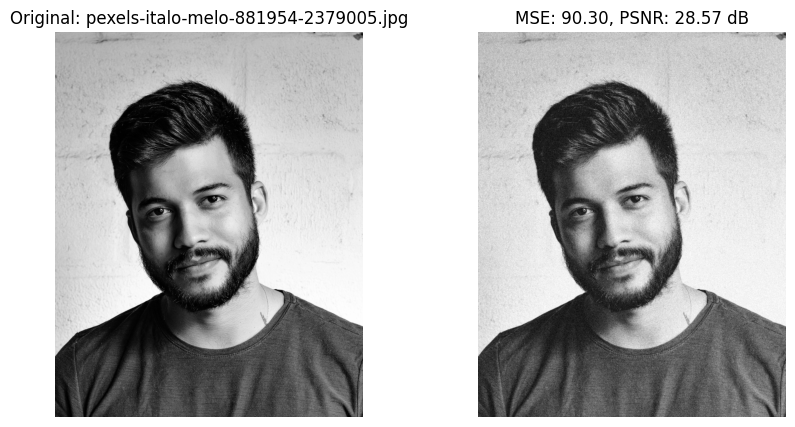

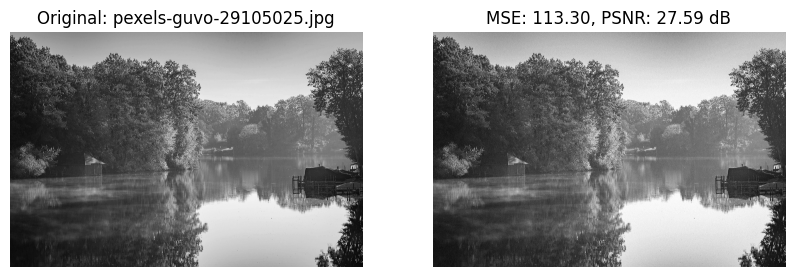

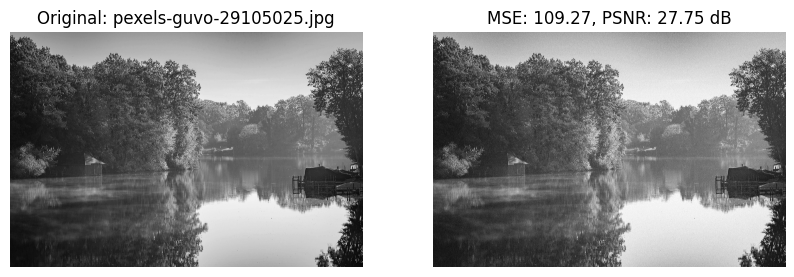

...

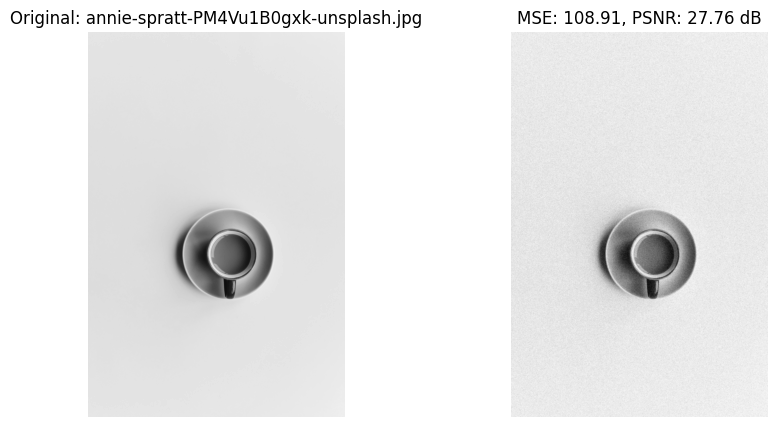

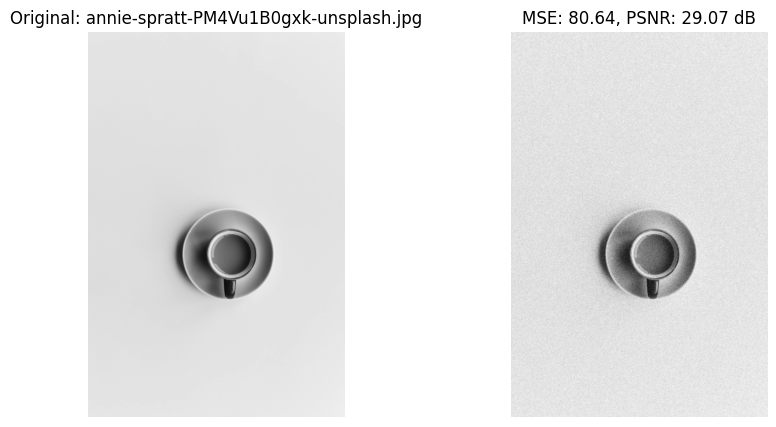

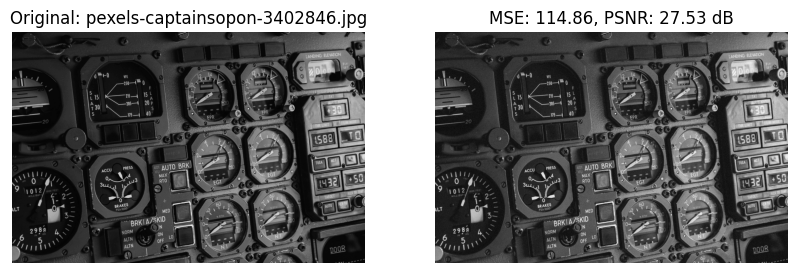

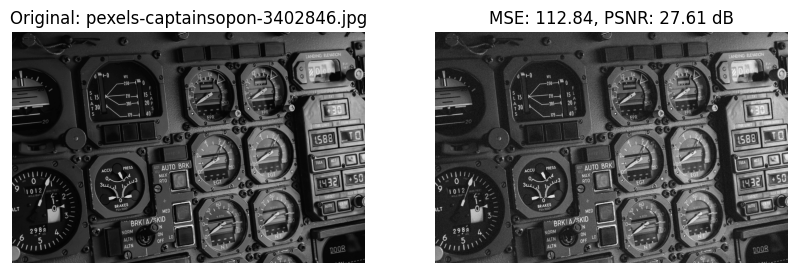

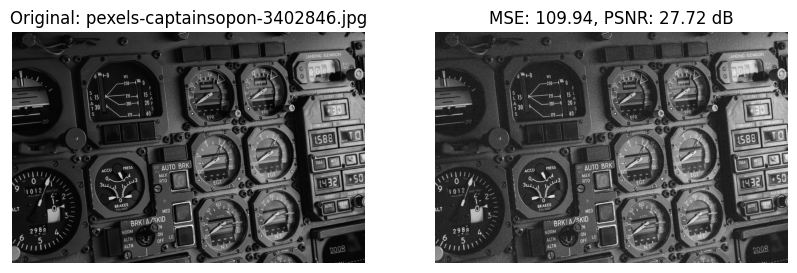

avarage mse = 104.55146811089986
avarage psnr = 27.9615223478786


In [30]:
counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
avarage_MSE["Gaussian"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
avarage_psnr["Gaussian"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

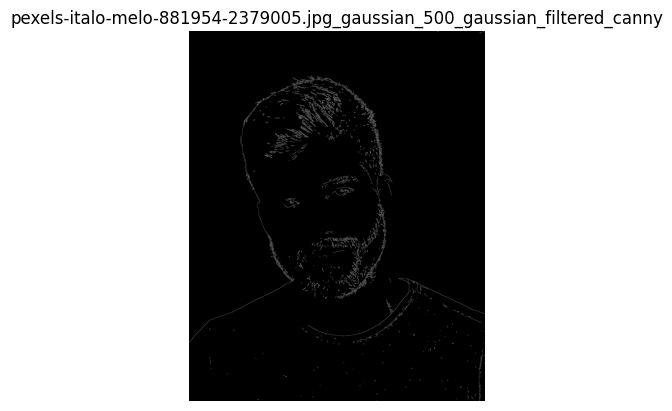

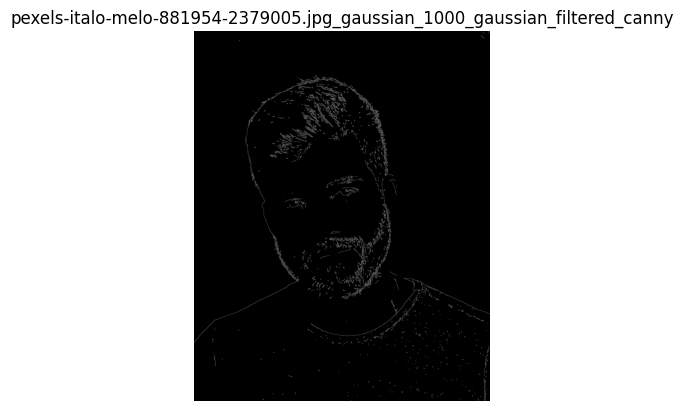

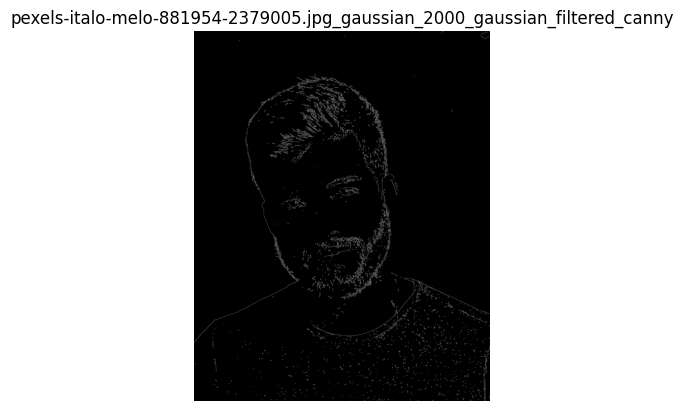

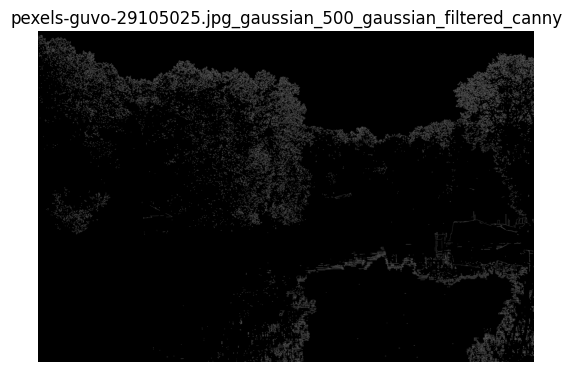

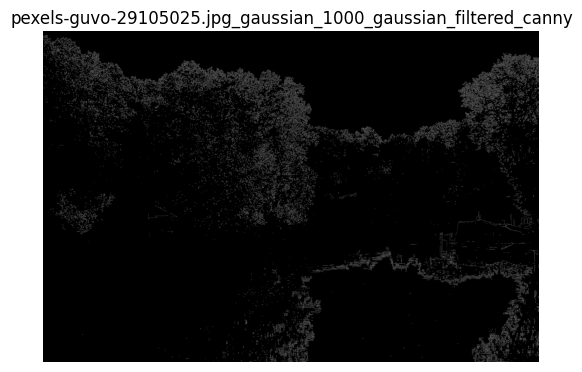

...

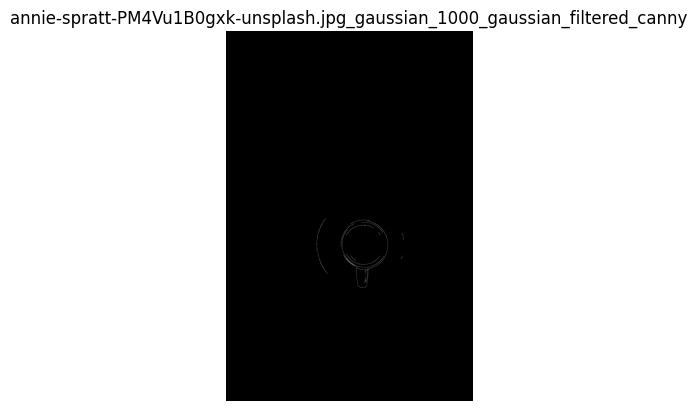

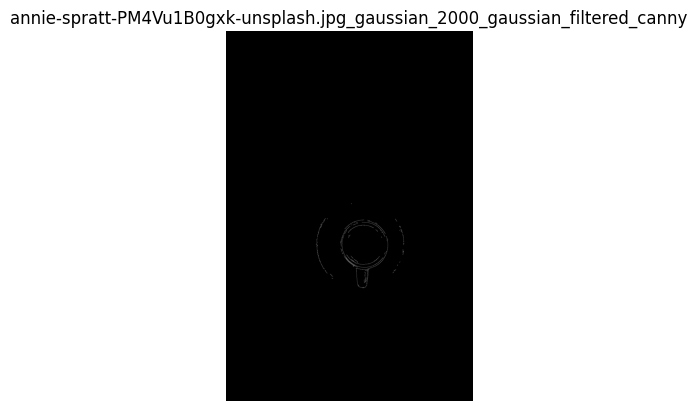

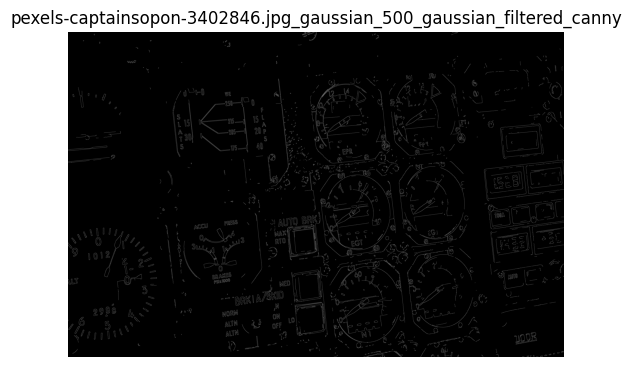

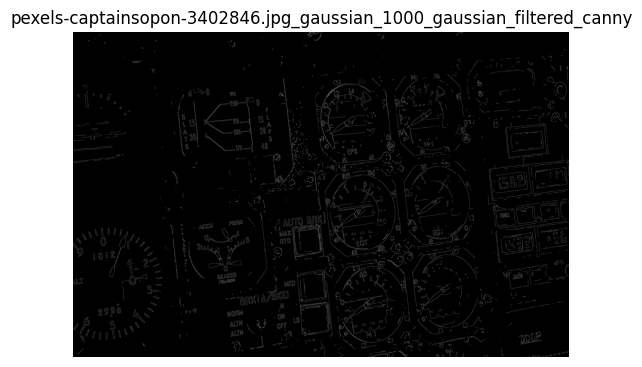

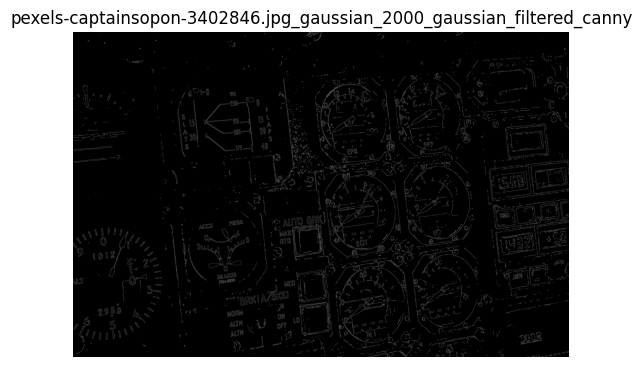

In [31]:
canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

Interesting enough, the problem here became too bad, that opposite results could be seen.


The filter smoothed the image too much that the fine edges became the same as the background, and now Canny doesn't detect them at all, instead of detecting them as thicker edges.

Increasing the Gaussian filter blurring won't help. It's safe to assume that the Gaussian filter isn't the best option to process an image with Gaussian noise before performing edge/object detection on it.

# Poisson Noise

In [33]:
def add_poisson_noise(image):
    noisy_image = np.random.poisson(image).astype(np.uint8)
    noisy_image = np.clip(noisy_image, 0, 255)
    return noisy_image

noisy_data_poisson = []

for index, row in original.iterrows():
    noisy_img = add_poisson_noise(row['image'])
    noisy_data_poisson.append({
        'filename': f"{row['filename']}_poisson",
        'image': noisy_img,
        'noise_type': 'poisson'
    })

noisy_poisson = pd.DataFrame(noisy_data_poisson)

In [40]:
Computational_times["Poisson"] = []
avarage_MSE["Poisson"] = []
avarage_psnr["Poisson"] = []

In [41]:
start_time = time.time()

filtered_data = []

for index, row in noisy_poisson.iterrows():
    filtered_img = apply_gaussian_filter(row['image'], ksize=(5, 5), sigma=1)
    filtered_data.append({
        'filename': f"{row['filename']}_gaussian_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Poisson"].append(total_time)
print(f"Total computational time for applying Gaussian filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Gaussian filter: 0.0865 seconds


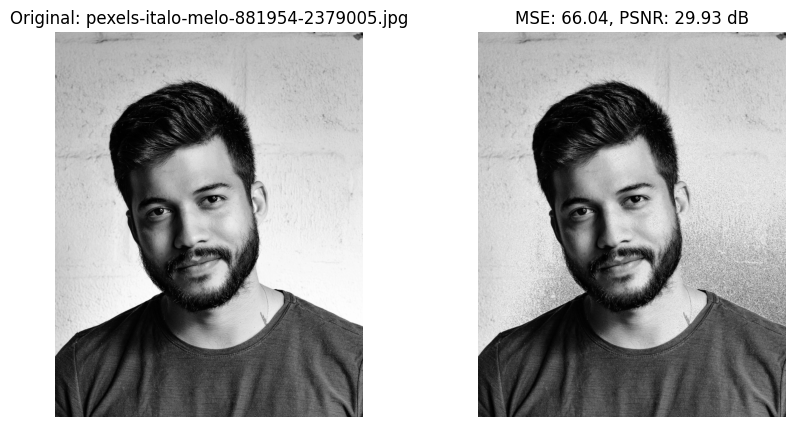

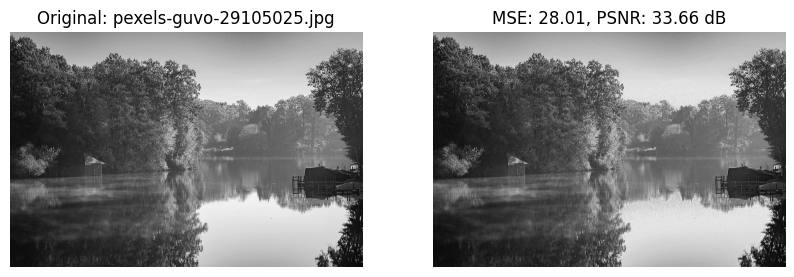

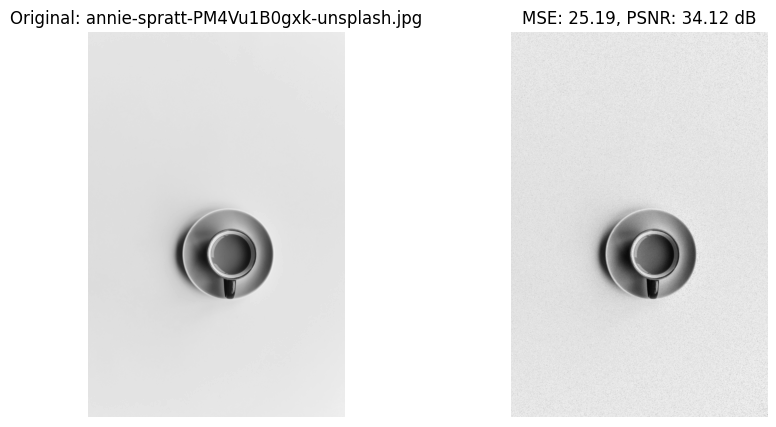

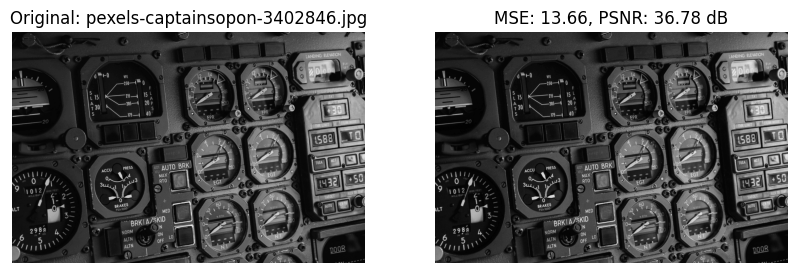

avarage mse = 33.22401273190895
avarage psnr = 33.62152720850567


In [42]:
counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
avarage_MSE["Poisson"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
avarage_psnr["Poisson"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

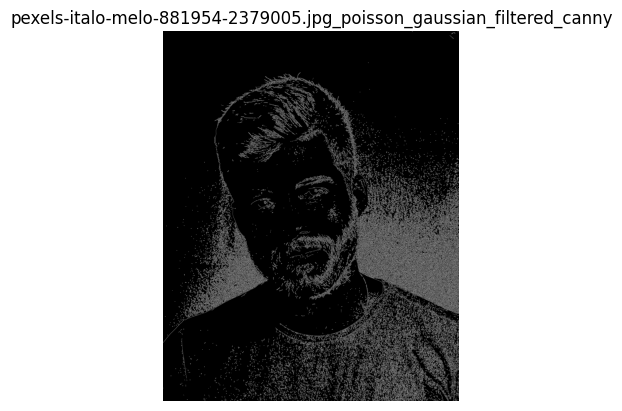

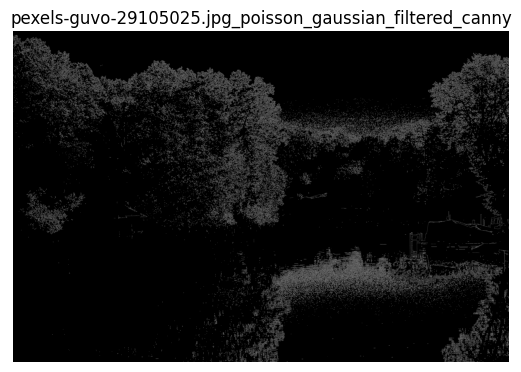

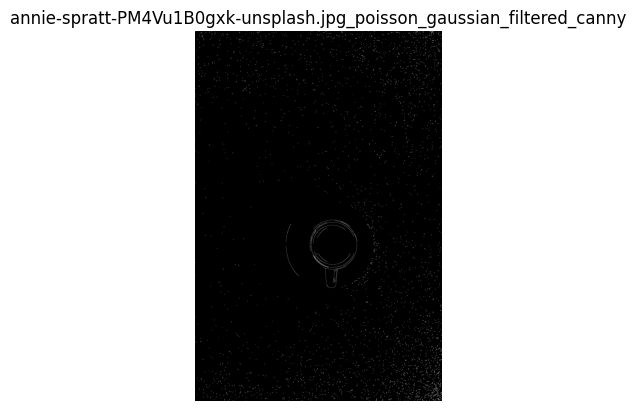

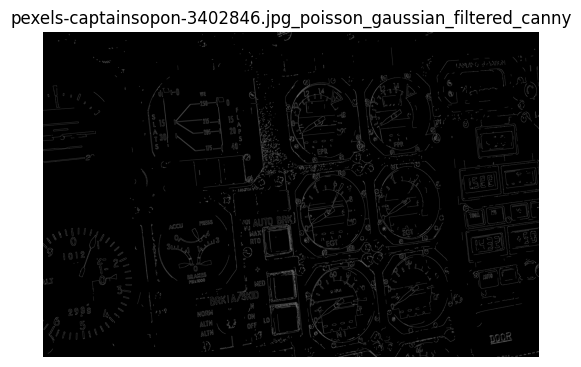

In [43]:
canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

Too much noise was detected as edges. The filter couldn't get rid of the noise effect as desired.

In [44]:
start_time = time.time()

filtered_data = []

for index, row in noisy_poisson.iterrows():
    filtered_img = apply_gaussian_filter(row['image'], ksize=(5, 5), sigma=2)
    filtered_data.append({
        'filename': f"{row['filename']}_gaussian_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Poisson"].append(total_time)
print(f"Total computational time for applying Gaussian filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Gaussian filter: 0.0798 seconds


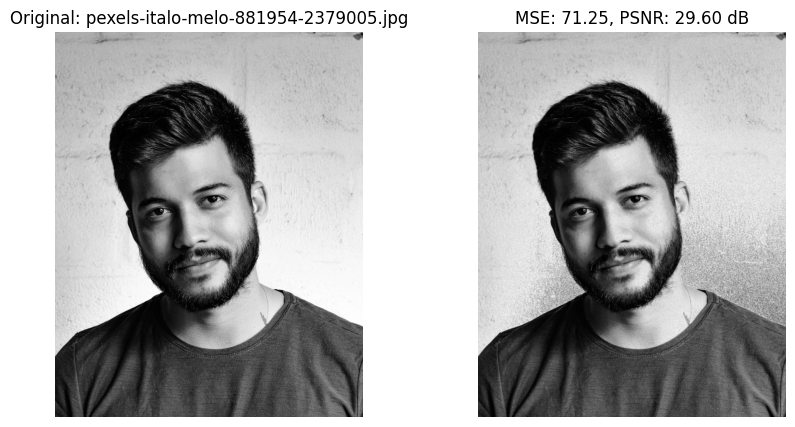

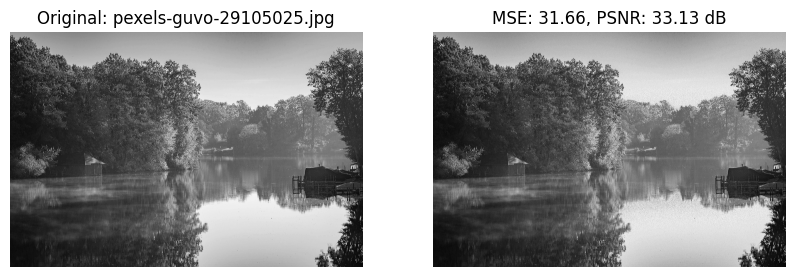

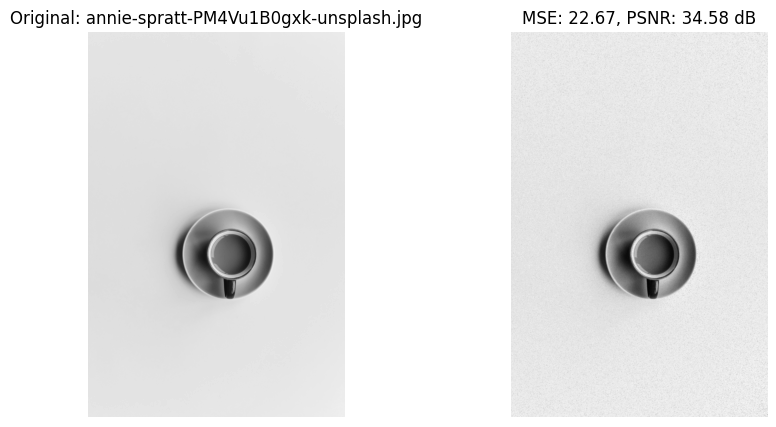

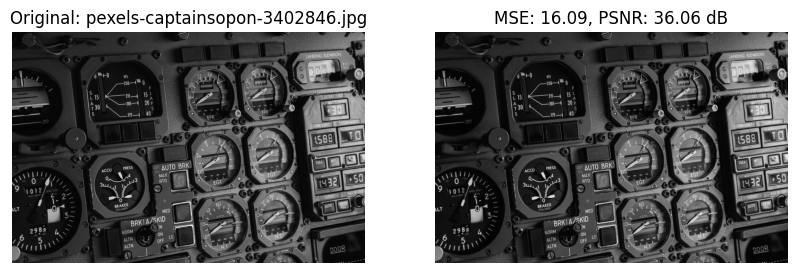

avarage mse = 35.41893123062656
avarage psnr = 33.34236457033346


In [45]:
counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
avarage_MSE["Poisson"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
avarage_psnr["Poisson"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

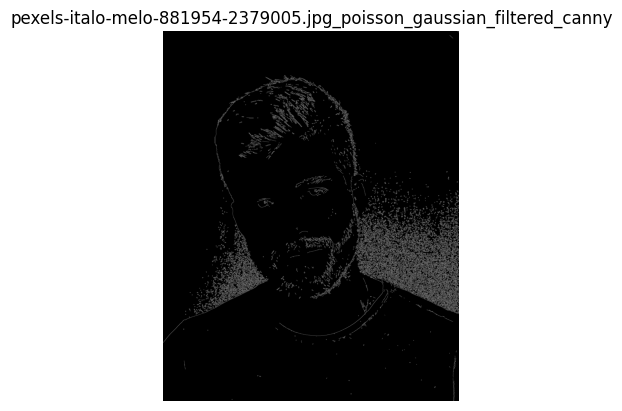

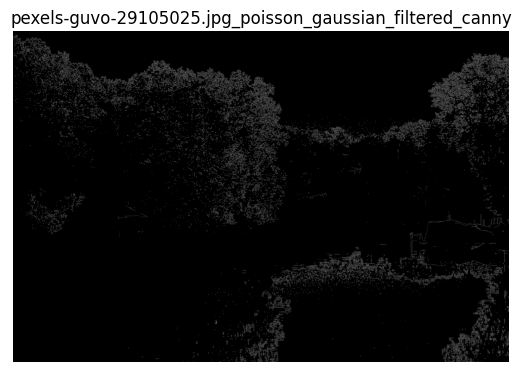

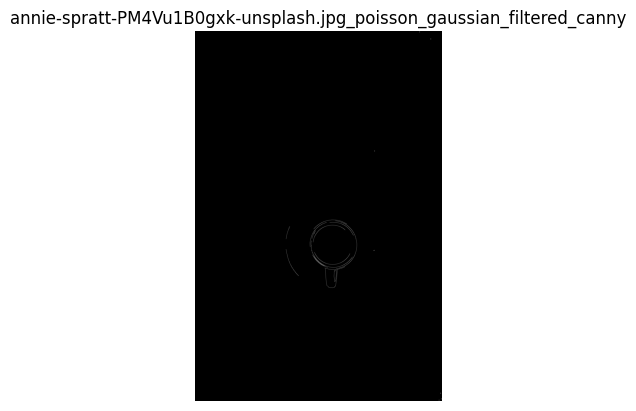

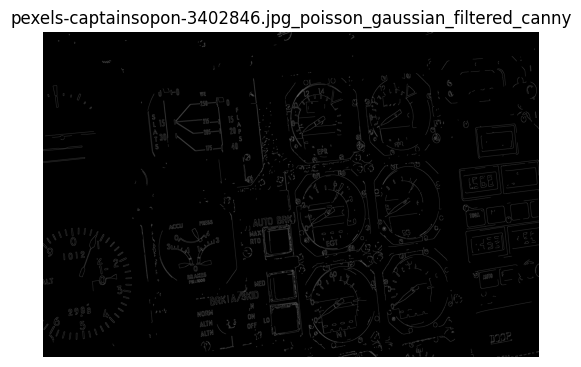

In [46]:
canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

less noise was detected as edges, and less fine edges as well.

# Speckle Noise:

In [47]:

def generate_speckle_noise(image_shape, mean=0, variance=0.01):
    noise = np.random.normal(mean, variance**0.5, size=image_shape)
    speckle_noise = noise * np.ones(image_shape)
    return speckle_noise

def add_speckle_noise(image, mean=0, variance=0.1):
    speckle_noise = generate_speckle_noise(image.shape, mean=mean, variance=variance)
    noisy_image = image + image * speckle_noise
    noisy_image = np.clip(noisy_image, 0, 255).astype(np.uint8)
    return noisy_image

speckle_variances = [0.05, 0.1, 0.2]

noisy_data_speckle = []

for index, row in original.iterrows():
    for var in speckle_variances:
        noisy_img = add_speckle_noise(row['image'], variance=var)
        noisy_data_speckle.append({
            'filename': f"{row['filename']}_speckle_{var}",
            'image': noisy_img,
            'variance': var
        })

speckle_noise = pd.DataFrame(noisy_data_speckle)

In [48]:
Computational_times["Speckle"] = []
avarage_MSE["Speckle"] = []
avarage_psnr["Speckle"] = []

In [49]:
start_time = time.time()

filtered_data = []

for index, row in speckle_noise.iterrows():
    filtered_img = apply_gaussian_filter(row['image'], ksize=(5, 5), sigma=1)
    filtered_data.append({
        'filename': f"{row['filename']}_gaussian_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Speckle"].append(total_time)
print(f"Total computational time for applying Gaussian filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Gaussian filter: 0.2040 seconds


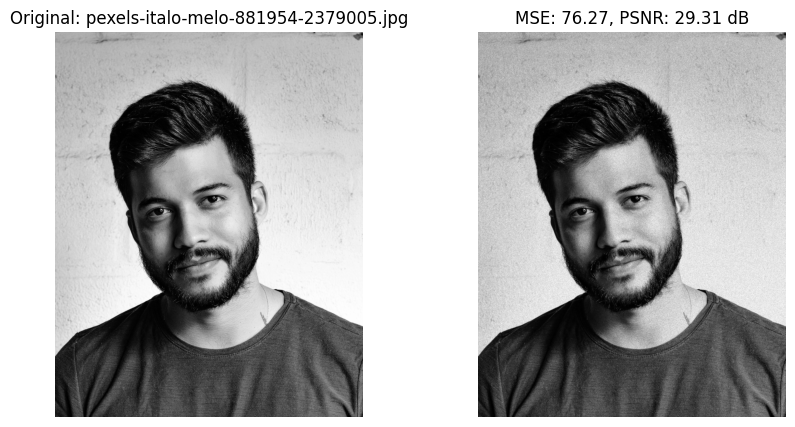

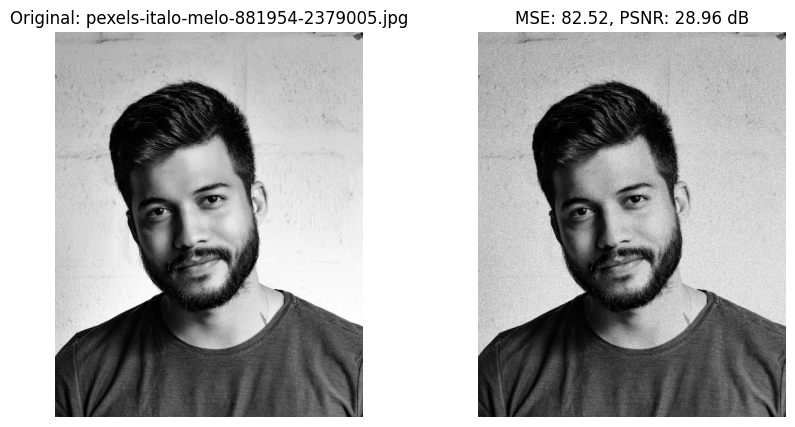

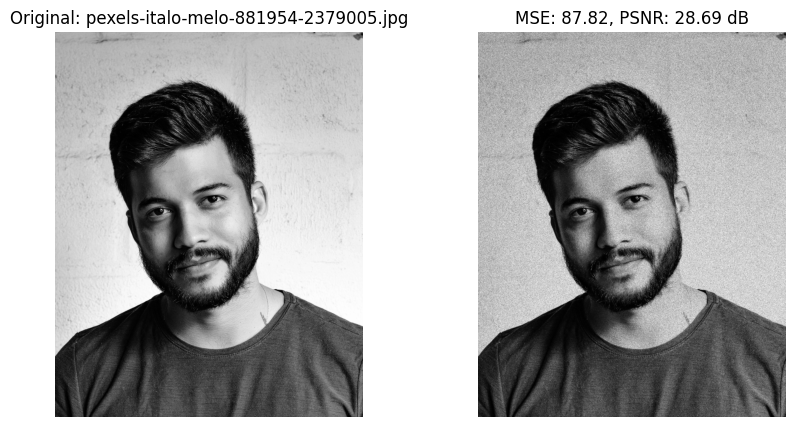

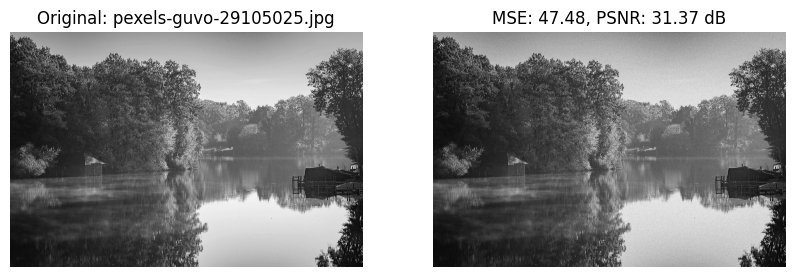

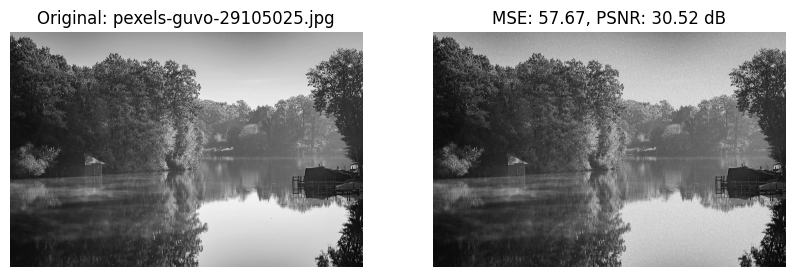

...

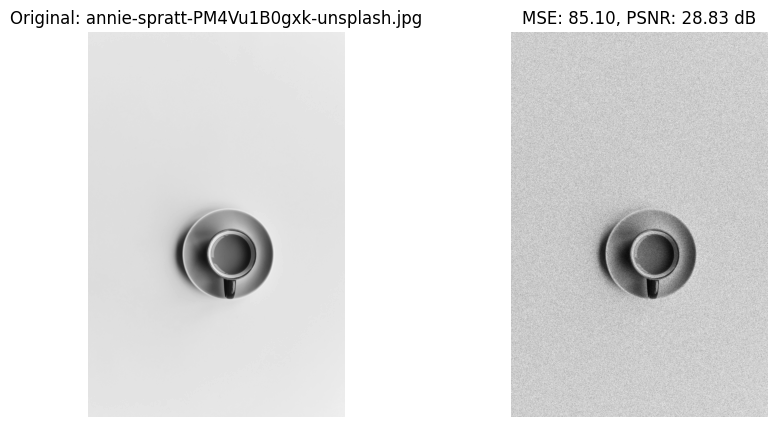

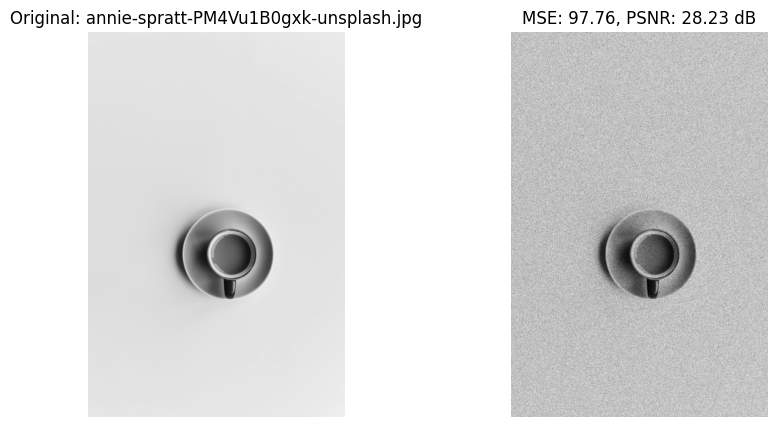

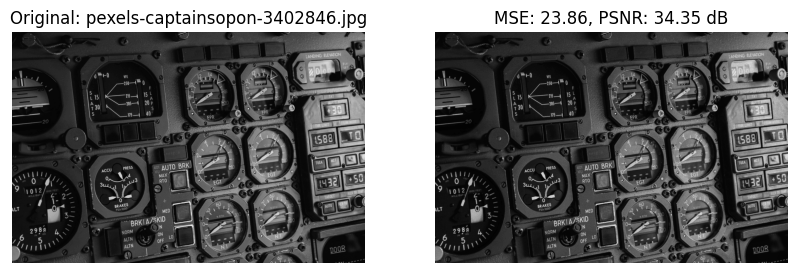

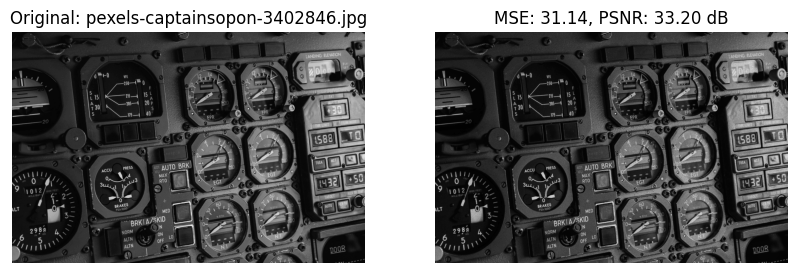

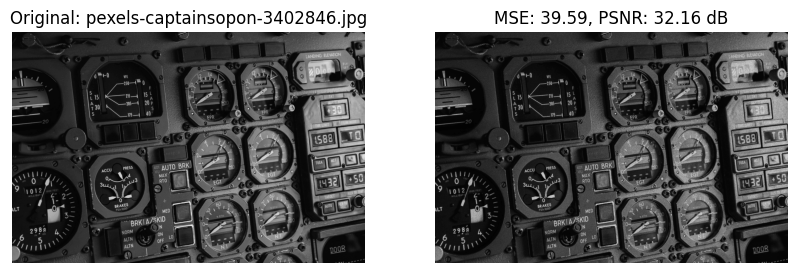

avarage mse = 63.9466704771419
avarage psnr = 30.424808635380305


In [50]:
counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
avarage_MSE["Speckle"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
avarage_psnr["Speckle"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

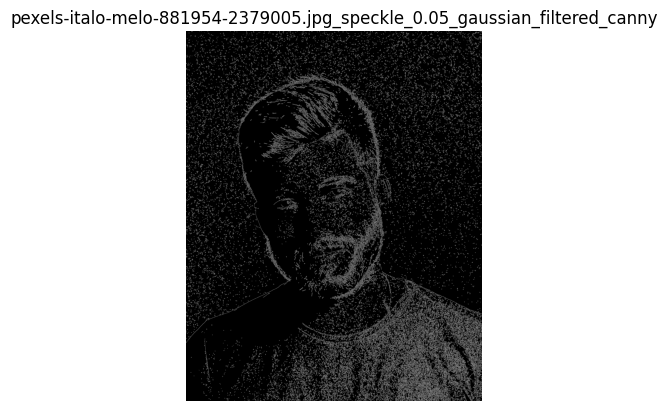

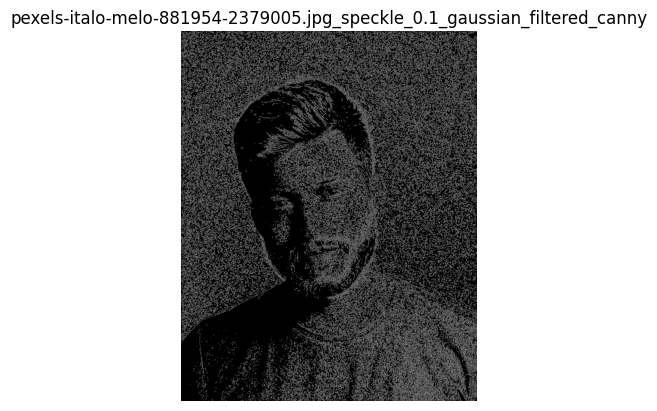

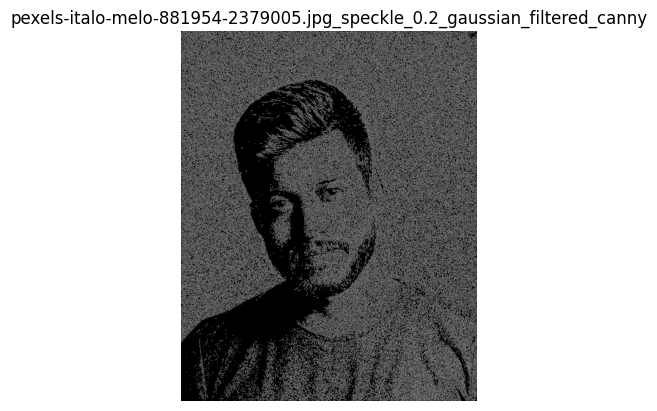

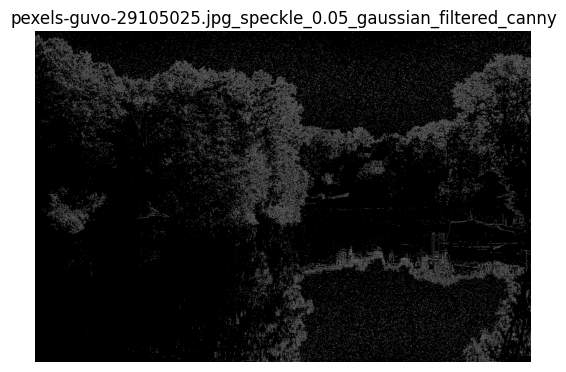

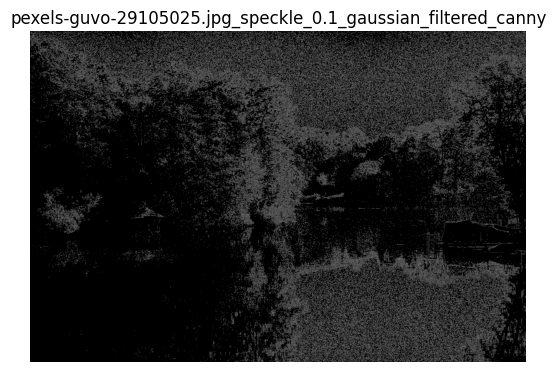

...

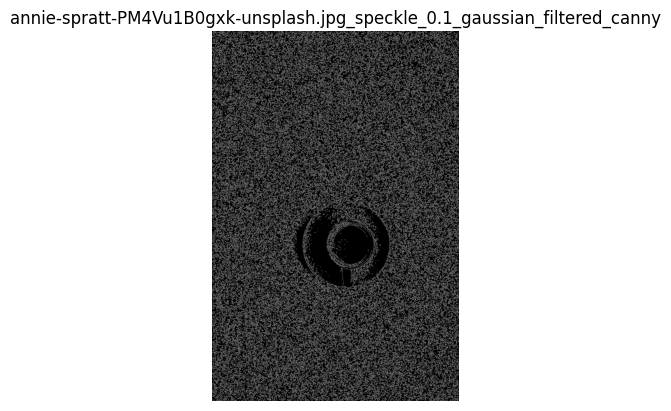

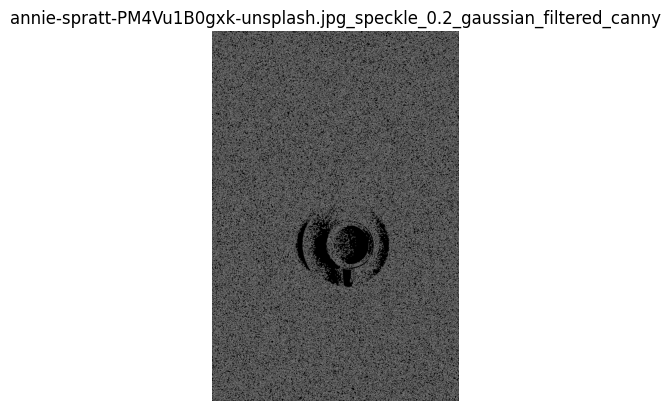

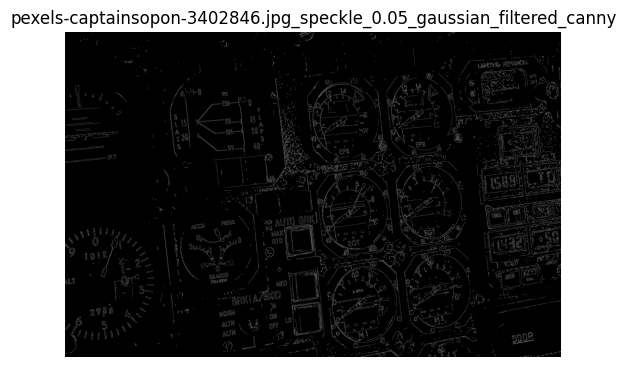

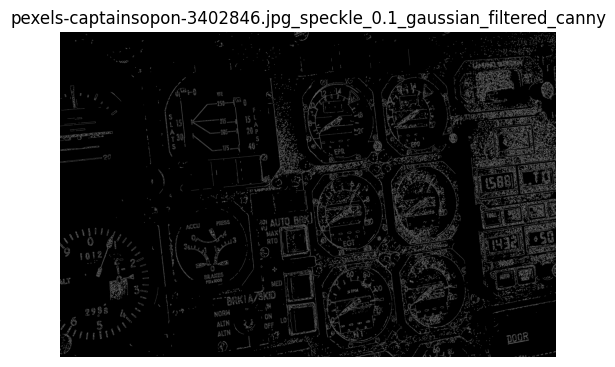

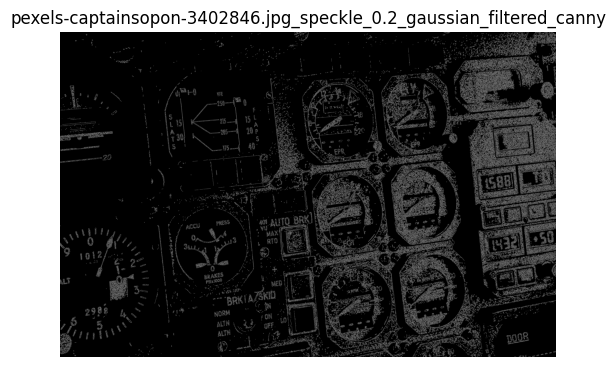

In [51]:
canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

Way too much noise was still can be seen in the images, and in the Canny's edges detection. Even images with a low level of noise couldn't be accepted as visually appealing, or edges detected with little/no noise.

In [52]:
start_time = time.time()

filtered_data = []

for index, row in speckle_noise.iterrows():
    filtered_img = apply_gaussian_filter(row['image'], ksize=(5, 5), sigma=2)
    filtered_data.append({
        'filename': f"{row['filename']}_gaussian_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Speckle"].append(total_time)
print(f"Total computational time for applying Gaussian filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Gaussian filter: 0.2051 seconds


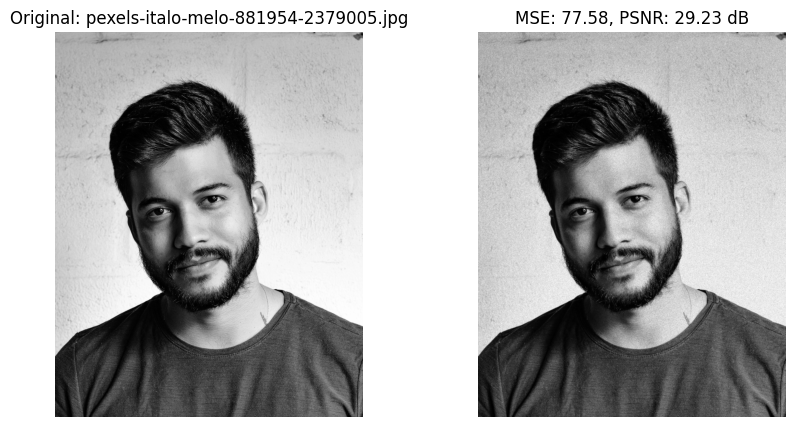

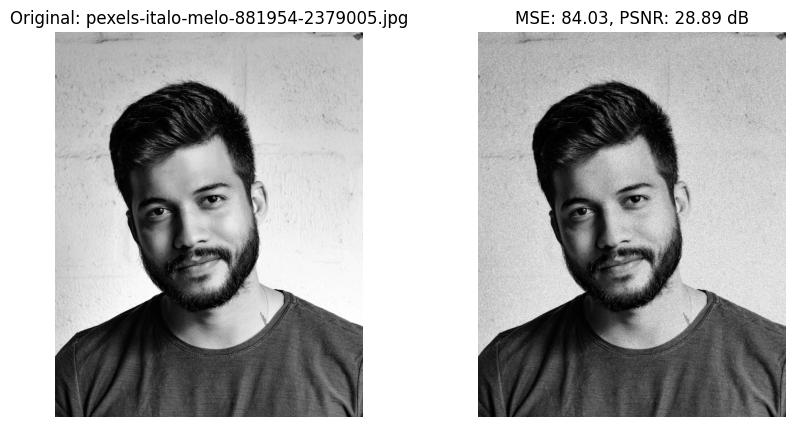

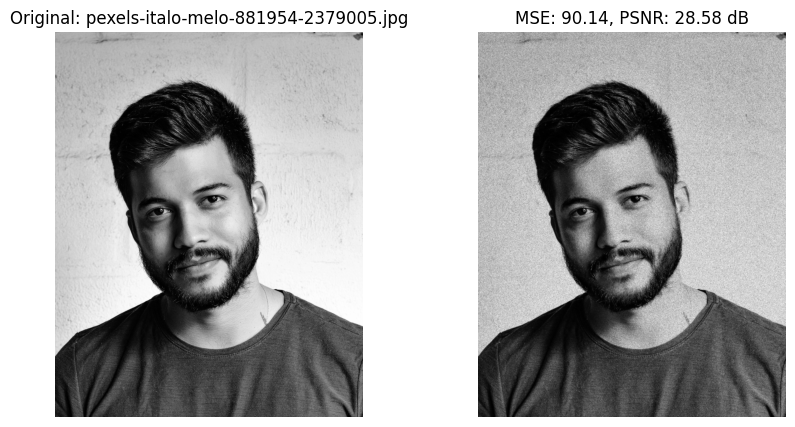

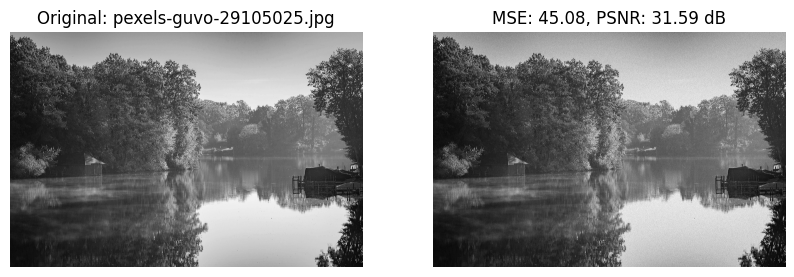

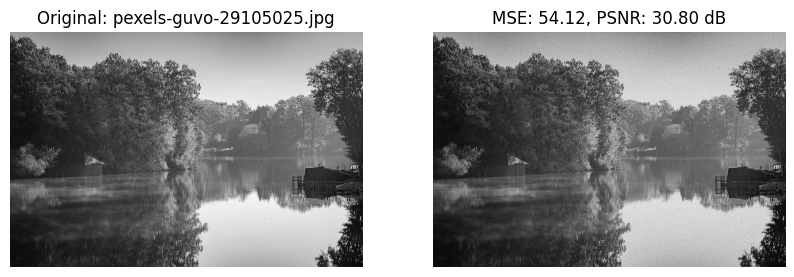

...

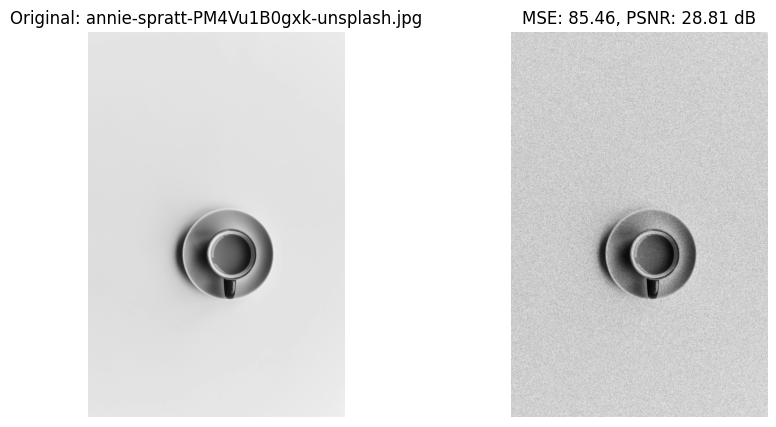

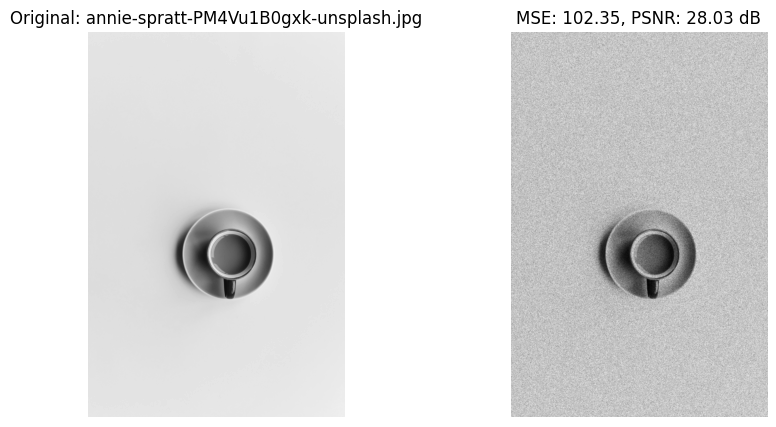

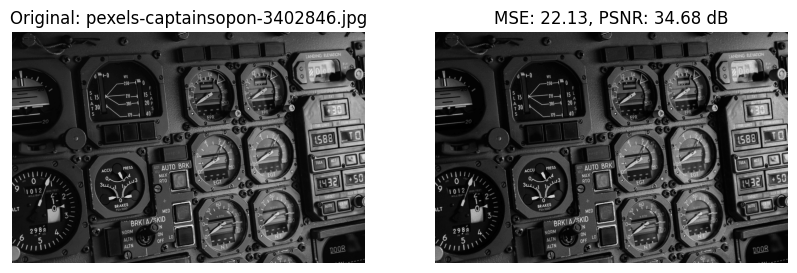

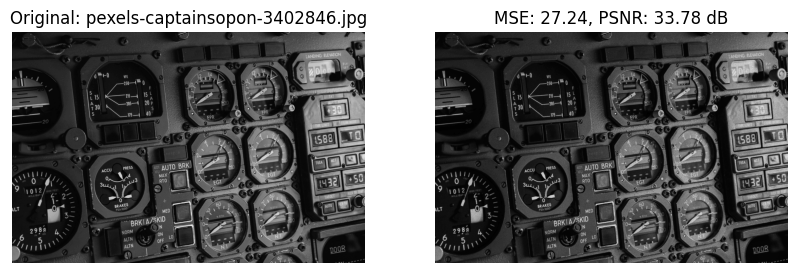

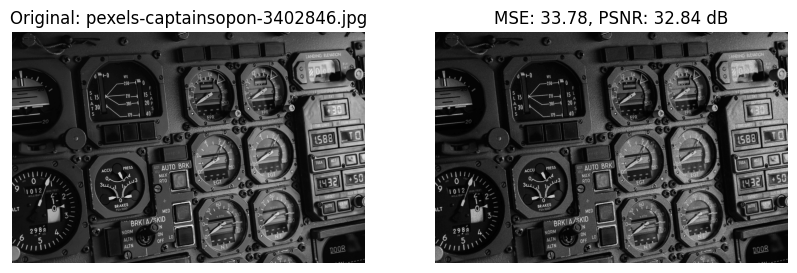

avarage mse = 62.36026746938759
avarage psnr = 30.62357655847326


In [53]:
counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
avarage_MSE["Speckle"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
avarage_psnr["Speckle"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

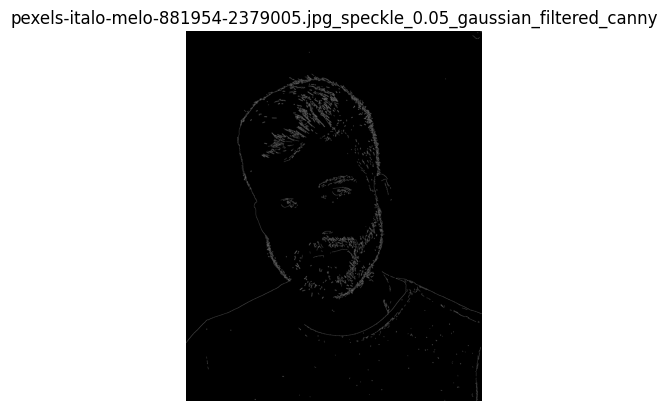

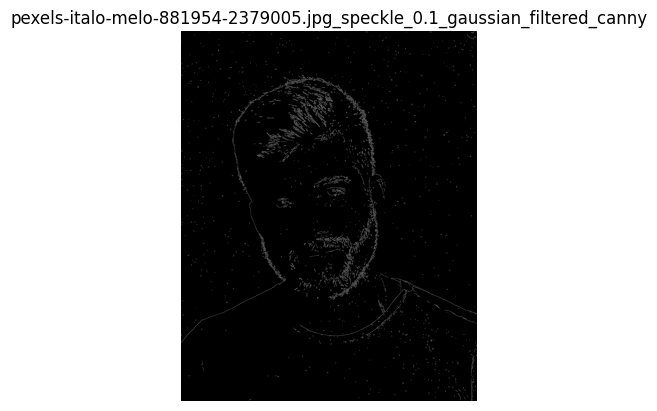

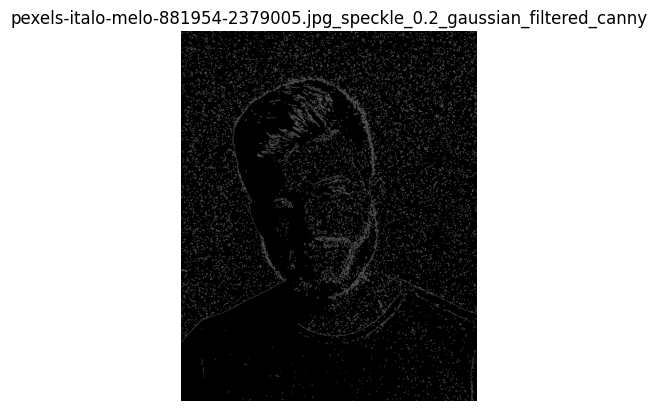

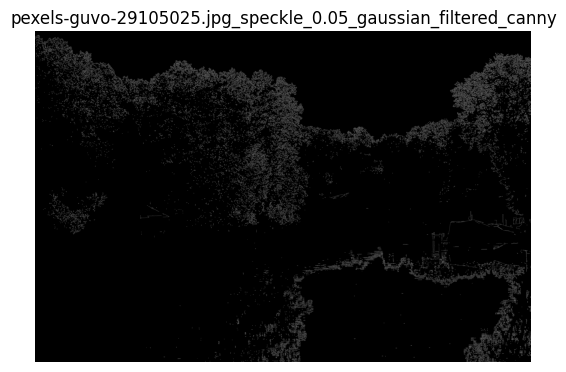

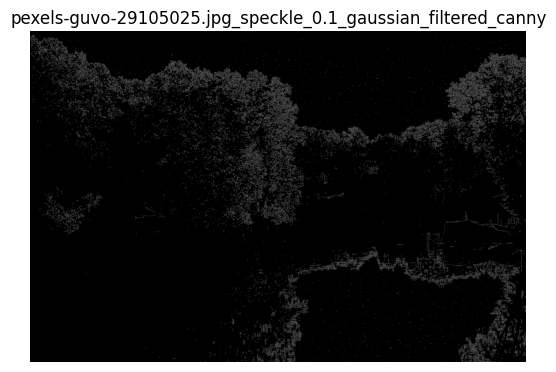

...

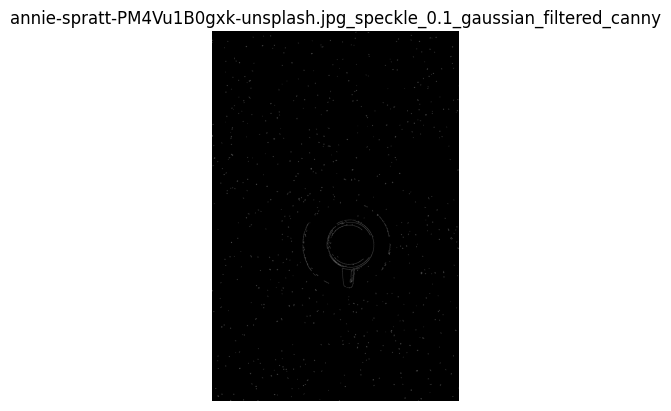

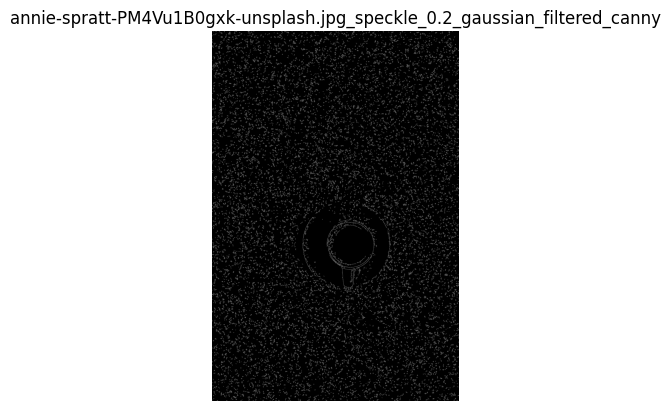

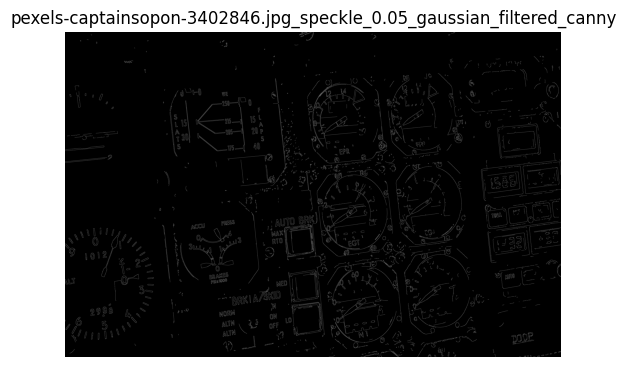

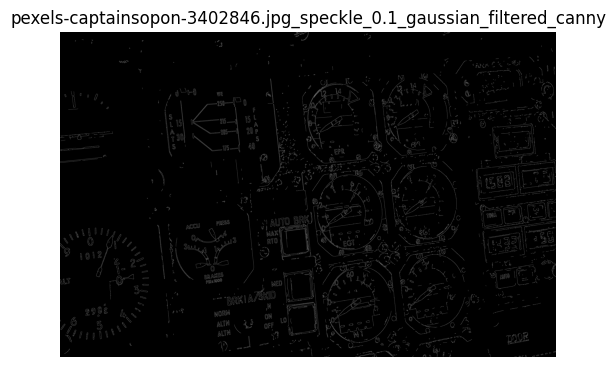

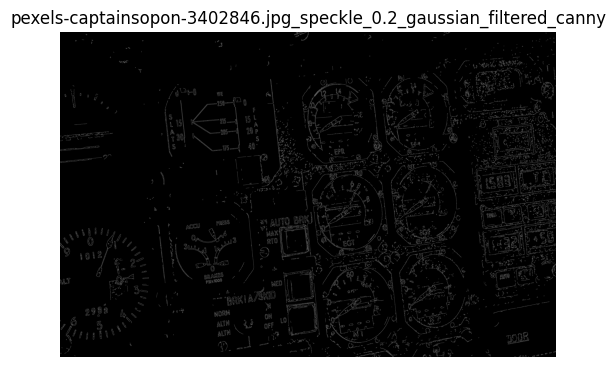

In [54]:
canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

With only bigger sigma, far less noise was detected as edges, and the images were much visually more appealing. Not much fine edges were sacrificed as the filter effect wasn't increased by a lot, as only sigma was added with the same kernel size.

# Results:

In [60]:
comp_times_salt_df = pd.DataFrame(Computational_times['Salt and Pepper'], index=['5x5 Kernel, sigma 1', '11x11 Kernel, sigma 2', '5x5 kernel, sigma 2', '11x11 kernel, sigma 1']).T
mse_salt_df = pd.DataFrame(avarage_MSE['Salt and Pepper'], index=['5x5 Kernel, sigma 1', '11x11 Kernel, sigma 2', '5x5 kernel, sigma 2', '11x11 kernel, sigma 1']).T
psnr_salt_df = pd.DataFrame(avarage_psnr['Salt and Pepper'], index=['5x5 Kernel, sigma 1', '11x11 Kernel, sigma 2', '5x5 kernel, sigma 2', '11x11 kernel, sigma 1']).T

In [64]:

comp_times_df = pd.DataFrame({
    'Gaussian': Computational_times['Gaussian'],
    'Poisson': Computational_times['Poisson'],
    'Speckle': Computational_times['Speckle']
}, index=['5x5 Kernel, sigma 1', '5x5 kernel, sigma 2']).T

mse_df = pd.DataFrame({
    'Gaussian': avarage_MSE['Gaussian'],
    'Poisson': avarage_MSE['Poisson'],
    'Speckle': avarage_MSE['Speckle']
}, index=['5x5 Kernel, sigma 1', '5x5 kernel, sigma 2']).T

psnr_df = pd.DataFrame({
    'Gaussian': avarage_psnr['Gaussian'],
    'Poisson': avarage_psnr['Poisson'],
    'Speckle': avarage_psnr['Speckle']
}, index=['5x5 Kernel, sigma 1', '5x5 kernel, sigma 2']).T

In [66]:
print("Computational Times for salt and pepper noise:")
comp_times_salt_df.style.set_caption("Computational Times").set_table_styles([{'selector': 'th', 'props': [('border', '1px solid black')]}])

Computational Times for salt and pepper noise:


,"5x5 Kernel, sigma 1","11x11 Kernel, sigma 2","5x5 kernel, sigma 2","11x11 kernel, sigma 1"
0,0.263983,0.961535,0.183414,0.397202


In [67]:
print("Computational Times other noise:")
comp_times_df.style.set_caption("Computational Times").set_table_styles([{'selector': 'th', 'props': [('border', '1px solid black')]}])

Computational Times other noise:


,"5x5 Kernel, sigma 1","5x5 kernel, sigma 2"
Gaussian,0.201066,0.212039
Poisson,0.086473,0.079837
Speckle,0.203967,0.205124


With increased kernel size, sigma or both, the computational time increases. But not in the same amount.

Increasing the kernel size will increase the computational time much more than only increasing sigma, as increasing the kernel size will lead the filter to perform more calculations. With a bigger kernel the filter will have more neihboring pixels to multibly by their weights, sum them, and calculate their average.


With increased sigma only the weight changes. The filter still has the same number of pixels and calculations.


Hence why increasing the kernel size increases the computational time a lot. While increasing sigma keeps it almost the same.

In [69]:
print("Average MSEs:")
mse_salt_df.style.set_caption("Average MSEs").set_table_styles([{'selector': 'th', 'props': [('border', '1px solid black')]}])

Average MSEs:


,"5x5 Kernel, sigma 1","11x11 Kernel, sigma 2","5x5 kernel, sigma 2","11x11 kernel, sigma 1"
0,57.240215,66.475137,63.479598,57.656651


In [70]:
print("Average MSEs:")
mse_df.style.set_caption("Average MSEs").set_table_styles([{'selector': 'th', 'props': [('border', '1px solid black')]}])

Average MSEs:


,"5x5 Kernel, sigma 1","5x5 kernel, sigma 2"
Gaussian,102.432053,104.551468
Poisson,33.224013,35.418931
Speckle,63.946670,62.360267


Increasing the kernel size increases MSE noticeably because the kernel will have a higher chance of containing more noise that it affects the new calculated value negatively.

Increasing sigma only leads to more smoothing at a still small size. The pixels' values move closer to each other, but not to a majority that could be noisy. Hence why the MSE didn't change much with only higher sigma, although visually and on Canny we could see a difference.

In [71]:
print("Average PSNRs:")
psnr_salt_df.style.set_caption("Average PSNRs").set_table_styles([{'selector': 'th', 'props': [('border', '1px solid black')]}])

Average PSNRs:


,"5x5 Kernel, sigma 1","11x11 Kernel, sigma 2","5x5 kernel, sigma 2","11x11 kernel, sigma 1"
0,31.420280,30.707600,30.842524,31.384868


In [72]:
print("Average PSNRs:")
psnr_df.style.set_caption("Average PSNRs").set_table_styles([{'selector': 'th', 'props': [('border', '1px solid black')]}])

Average PSNRs:


,"5x5 Kernel, sigma 1","5x5 kernel, sigma 2"
Gaussian,28.044699,27.961522
Poisson,33.621527,33.342365
Speckle,30.424809,30.623577


Not much difference could be seen on the average PSNR.